# **Лабораторная работа**
*Naumov Anton (Any0019)*

*To contact me in telegram: @any0019*

В данном задании вашей задачей будет построить и обучить модель CycleGAN для задачи Img2Img.

---

Про задачу __Img2Img__:

- У вас есть 2 множества изображений ($A$ и $B$)
- Ваша задача - научиться превращать изображения из множества $A$ в изображения из множества $B$ и наоборот
- Бывают paired и unpaired множества
- В случае __paired__ множеств - для каждого изображения из $A$ существует конкретное изображение из $B$, в которое оно должно перейти (и наоборот). Примером такой пары множеств может быть (а) спутниковая фотграфия местности vs схематическая карта местности , (б) фотография фасада здания vs схема фасада здания , ...
- В случае __unpaired__ множеств - между множествами нет конкретных пар. Примером такой пары множеств может быть (а) фотографии с лошадьми vs фотографии с зебрами , (б) фотографии vs рисунки конкретного художника , ...

---

Про модель __CycleGAN__:

- Модель придумана для задачи Img2Img (в первую очередь unpaired версии) и основана на концепции GAN-ов
- В модели есть 2 генератора: $G_{A -> B}$ (задача которого - принимая на вход изображение из множества $A$ переводить его в изображение из множества $B$) и $G_{B -> A}$ (аналогично в другую сторону)
- Надо отметить что на вход генераторы не получают никакую дополнительную случайность, что делает обучение таких моделей проще
- В модели так же есть 2 дискриминатора: $D_{A}$ (задача которого - отличать реальные изображения из $A$ от сгенерированных с помощью $G_{B -> A}$ изображений) и $D_{B}$ (аналогично для $B$)
- Функцией ошибки будет, как и для GAN-ов, minmax игра между генераторами и дискриминаторами, но к ошибке генераторов добавится ещё и, так называемый, `cycle consistency loss`, который проверяет, что после двойного перехода изображения не меняются $G_{B -> A} \big( G_{A -> B} ( a ) \big) = a ; \forall a \in A$ и $G_{A -> B} \big( G_{B -> A} ( b ) \big) = b ; \forall b \in B$
- Так же можно добавлять или нет штраф за то, чтобы $G_{B -> A}$ не меняла изображения из $A$ и наоборот $G_{A -> B}$ не меняла изображения из $B$
- Оригинальная статья: https://arxiv.org/pdf/1703.10593.pdf

---

Ваша задача - ноутбук разбит на несколько частей, каждая со своими баллами

1. __Подготовка данных__ _(2 балла)_ --> требуется выбрать датасет для обучения (дано несколько на выбор) и составить пайплайн подготовки данных
2. __Составление модели__ _(6 баллов)_ --> требуется собрать нейросеть _(3 балла)_ и создать функции ошибки _(3 балла)_
3. __Подготовка обучения__ _(2 балла)_ --> требуется написать шаги обучения и валидации, визуализацию, а так же полный цикл обучения
4. __Обучение__ _(2 балла)_ --> требуется обучить модель
5. __Сбор своего датасета и обучение модели на нём__ _(3 балла)_ --> требуется собрать свой датасет и обучить на нём модель

***За наиболее интересные и качественные решения в пункте 5 так же предусмотрены дополнительные баллы***

In [1]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
from torchvision import datasets, transforms as tr

import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

from tqdm.auto import tqdm, trange
from PIL import Image
from dataclasses import dataclass
from typing import Tuple

import os
import sys
import requests
import cv2
import warnings

from tqdm.auto import tqdm

torch.backends.cudnn.benchmark = True
warnings.filterwarnings('ignore')

# 1. Подготовка данных (___2 балла___)

## 1.1 Выбор и скачивание датасета

Dataset 'vangogh2photo'
Loading zip file... --> done!
Unziping...

--2025-04-09 19:08:48--  http://efrosgans.eecs.berkeley.edu/cyclegan/datasets/vangogh2photo.zip
Resolving efrosgans.eecs.berkeley.edu (efrosgans.eecs.berkeley.edu)... 128.32.244.190
Connecting to efrosgans.eecs.berkeley.edu (efrosgans.eecs.berkeley.edu)|128.32.244.190|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 306590349 (292M) [application/zip]
Saving to: ‘/home/jupyter/datasphere/project/datasets/img2img/vangogh2photo.zip’

     0K .......... .......... .......... .......... ..........  0%  127K 39m15s
    50K .......... .......... .......... .......... ..........  0%  250K 29m36s
   100K .......... .......... .......... .......... ..........  0%  245K 26m30s
   150K .......... .......... .......... .......... ..........  0%  266M 19m53s
   200K .......... .......... .......... .......... ..........  0% 47.9K 36m43s
   250K .......... .......... .......... .......... ..........  0%  247M 30m35s
   300K .......... .......... .......... .......... .........

 --> done!
Provided splits: ['trainA', 'testB', 'trainB', 'testA']
Split 'testA' of dataset 'vangogh2photo' --> size: 400


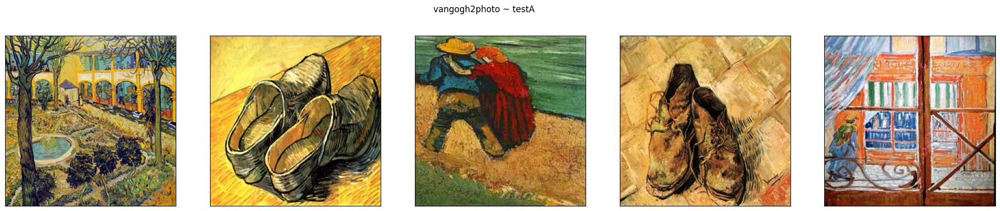

Split 'testB' of dataset 'vangogh2photo' --> size: 751


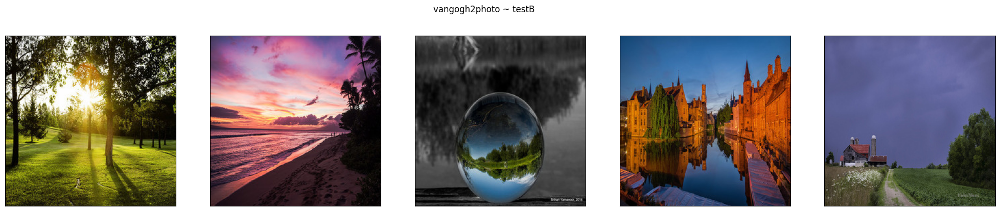

Split 'trainA' of dataset 'vangogh2photo' --> size: 400


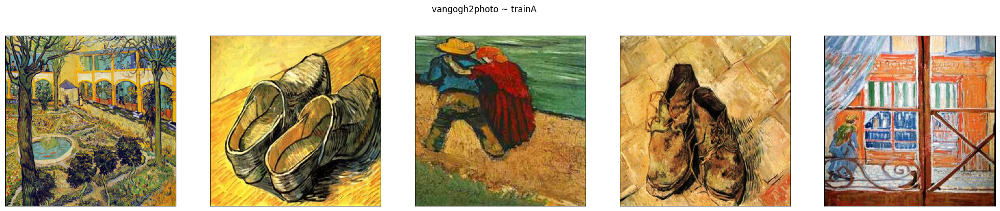

Split 'trainB' of dataset 'vangogh2photo' --> size: 6287


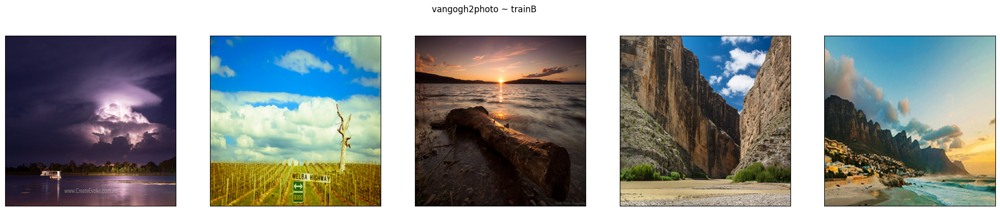


----------------------------



In [5]:
dataset_folder = "/home/jupyter/datasphere/project/datasets/img2img"
num_images_per_split = 5

os.environ["dataset_folder"] = dataset_folder
!mkdir -p ${dataset_folder}

# В этом цикле каждый из предложенных датасетов
#  - скачивается
#  - распаковывается
#  - отрисовывается + meta
#  - удаляется

# Предлагается посмотреть на все предложенные варианты датасетов и затем оставить один,
#  с которым захочется работать больше всего - закомментируйте (или удалите) все, кроме
#  выбранного, а так же закомментируйте строчки с удалением скачанного датасета
for dataset_name in [
    # Unpaired
    # "apple2orange",
    # "summer2winter_yosemite",
    # "horse2zebra",
    # "monet2photo",
    # "cezanne2photo",
    # "ukiyoe2photo",
    "vangogh2photo",
    # Paired
    # "maps",
    # "facades",
]:
    print(f"Dataset '{dataset_name}'")
    url = f"http://efrosgans.eecs.berkeley.edu/cyclegan/datasets/{dataset_name}.zip"
    download_path = os.path.join(dataset_folder, f"{dataset_name}.zip")
    target_folder = os.path.join(dataset_folder, dataset_name)
    
    # Чтобы bash вызовы знали соответствующие переменные
    os.environ["url"] = url
    os.environ["download_path"] = download_path
    os.environ["target_folder"] = target_folder
    
    print("Loading zip file...", end="")
    # Проверяем что нет такого загруженого файла
    if not os.path.isfile(download_path) or os.path.exists(target_folder):
        # # Можно загрузить через requests библиотеку
        # response = requests.get(url)
        # open(download_path, "wb").write(response.content)
        
        # Можно загрузить через wget
        !wget ${url} -O ${download_path}
    print(" --> done!")
    
    print("Unziping...", end="")
    # Распаковываем
    if os.path.exists(target_folder):
        !rm -r ${target_folder}
    !mkdir -p ${dataset_folder}
    !unzip -qq ${download_path} -d ${dataset_folder}
    print(" --> done!")
    
    # Удаляем zip-файл
    !rm ${download_path}
    
    # Meta + Отрисовка
    print(f"Provided splits: {os.listdir(target_folder)}")
    # Удобный способ быстро получить датасет картинок с лэйблами, если картинки разложены по папкам в формате:
    # root_folder/label_name/img.jpg
    # (в нашем случае нет лэйблов, но картинки разложены в таком же формате, просто вместо label_name идёт
    #  split_name: trainA/testA/trainB/testB)
    dataset = datasets.ImageFolder(target_folder)

    inds_to_show = {i: [] for i, _ in enumerate(dataset.classes)}
    classes_full = 0
    for dataset_ind in range(len(dataset)):
        _, split_ind = dataset[dataset_ind]
        if len(inds_to_show[split_ind]) == num_images_per_split:
            continue
        inds_to_show[split_ind].append(dataset_ind)
        if len(inds_to_show[split_ind]) == num_images_per_split:
            classes_full += 1
        if classes_full == len(dataset.classes):
            break

    for split_name in sorted(dataset.classes):
        split_ind = dataset.class_to_idx[split_name]
        print(f"Split '{split_name}' of dataset '{dataset_name}'", end="")
        split_folder = os.path.join(target_folder, split_name)
        print(f" --> size: {len(os.listdir(split_folder))}")

        plt.subplots(1, num_images_per_split, figsize=(5 * num_images_per_split, 5))
        plt.suptitle(f"{dataset_name} ~ {split_name}", y=0.95)
        for i, dataset_ind in enumerate(inds_to_show[split_ind]):
            plt.subplot(1, num_images_per_split, i + 1)
            plt.imshow(dataset[dataset_ind][0])
            plt.xticks([])
            plt.yticks([])
        plt.show()
    
    # Удаляем скачанный датасет
    # !rm -r ${target_folder}
    
    print("\n----------------------------\n")

## 1.2 Dataset и Transforms

В папке `target_folder` находятся несколько папок со сплитами для соответствующего датасета, в каждой папке сплита находятся сами `.jpg` изображения.

Давайте составим их в удобном для нас виде в отдельные датасеты для каждого сплита без лэйблов.

Для получения картинок можно использовать 
```python
cv2.imread(img_path)[:, :, ::-1]  # каналы записаны в обратном порядке
```

In [2]:
# Выбранный выше и скачанный датасет
dataset_folder = "/home/jupyter/datasphere/project/datasets/img2img"
dataset_name = "vangogh2photo"
target_folder = os.path.join(dataset_folder, dataset_name)

# Класс для датасета изображений без лэйблов с применением трансформов
class ImageDatasetNoLabel(Dataset):
    def __init__(self, root_dir, transform=None):
        self.root_dir = root_dir
        self.transform = transform
        self.image_paths = [
            os.path.join(root_dir, f) for f in os.listdir(root_dir) 
            if f.lower().endswith(('.png', '.jpg', '.jpeg'))
        ]
    
    def __getitem__(self, index):
        img_path = self.image_paths[index]
        image = cv2.imread(img_path)[:, :, ::-1]  # BGR → RGB
        
        if self.transform:
            # Конвертируем numpy array в PIL Image
            image_pil = Image.fromarray(image)
            image = self.transform(image_pil)
        
        return image
    
    def __len__(self):
        return len(self.image_paths)

# Удобный класс для хранения всех наших датасетов
@dataclass
class DatasetsClass:
    train_a: ImageDatasetNoLabel
    train_b: ImageDatasetNoLabel
    test_a: ImageDatasetNoLabel
    test_b: ImageDatasetNoLabel


# Все датасеты без трансформов - чтобы посчитать статистики
ds = DatasetsClass(
    train_a=ImageDatasetNoLabel(os.path.join(target_folder, "trainA")),
    train_b=ImageDatasetNoLabel(os.path.join(target_folder, "trainB")),
    test_a=ImageDatasetNoLabel(os.path.join(target_folder, "testA")),
    test_b=ImageDatasetNoLabel(os.path.join(target_folder, "testB")),
)

In [3]:
def get_channel_statistics(dataset):
    """
    Функция для получения поканальных статистик (среднее и отклонение) по датасету.
    Использует __getitem__ из ImageDatasetNoLabel для согласованности.
    """
    pixel_sum = np.zeros(3)
    pixel_sq_sum = np.zeros(3)
    num_pixels = 0
    
    for i in range(len(dataset)):
        img = dataset[i]
        
        if isinstance(img, Image.Image):
            img = np.array(img) / 255.0
        else:
            img = img.astype(np.float32) / 255.0
        
        if img.ndim == 3 and img.shape[2] == 3:
            img = np.transpose(img, (2, 0, 1))
        
        pixel_sum += img.sum(axis=(1, 2))
        pixel_sq_sum += (img ** 2).sum(axis=(1, 2))
        num_pixels += img.shape[1] * img.shape[2]
    
    channel_mean = pixel_sum / num_pixels
    channel_std = np.sqrt(pixel_sq_sum / num_pixels - channel_mean ** 2)
    
    return tuple(channel_mean), tuple(channel_std)

# Поканальное среднее и отклонение для A
channel_mean_a, channel_std_a = get_channel_statistics(ds.train_a)
print(f"Domain A (summer): mean={channel_mean_a}, std={channel_std_a}")

# Поканальное среднее и отклонение для B
channel_mean_b, channel_std_b = get_channel_statistics(ds.train_b)
print(f"Domain B (winter): mean={channel_mean_b}, std={channel_mean_b}")

Domain A (summer): mean=(0.5184308471158147, 0.4951960670575499, 0.3369842043891549), std=(0.25279386537818516, 0.2303822883598352, 0.23068521704484143)
Domain B (winter): mean=(0.4122769082177218, 0.4092729568951921, 0.3926440348194186), std=(0.4122769082177218, 0.4092729568951921, 0.3926440348194186)


Domain A (summer):


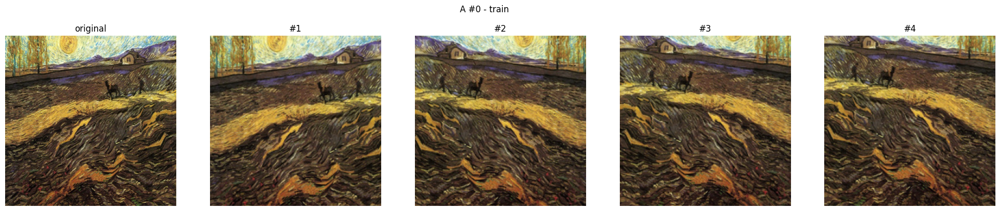

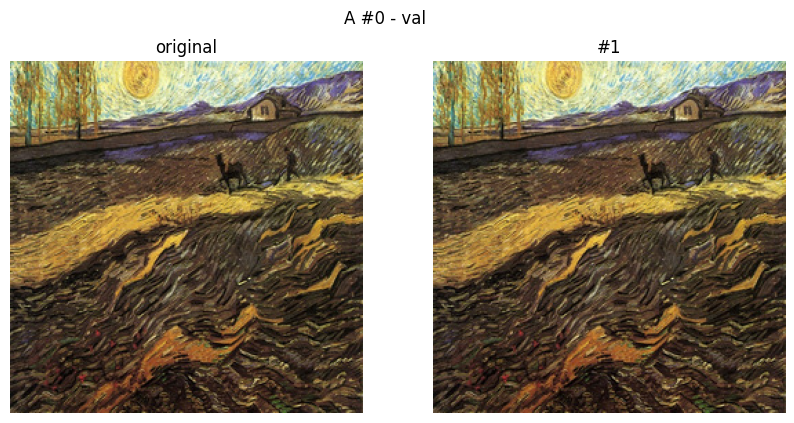


Domain B (winter):


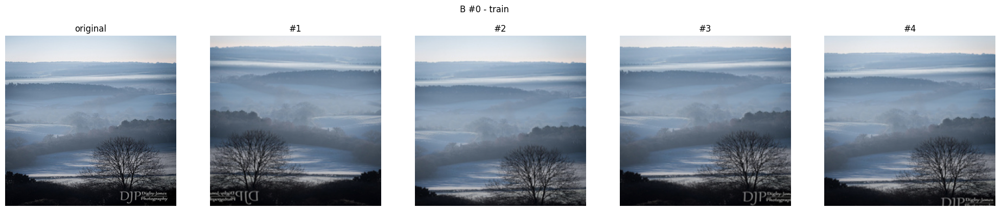

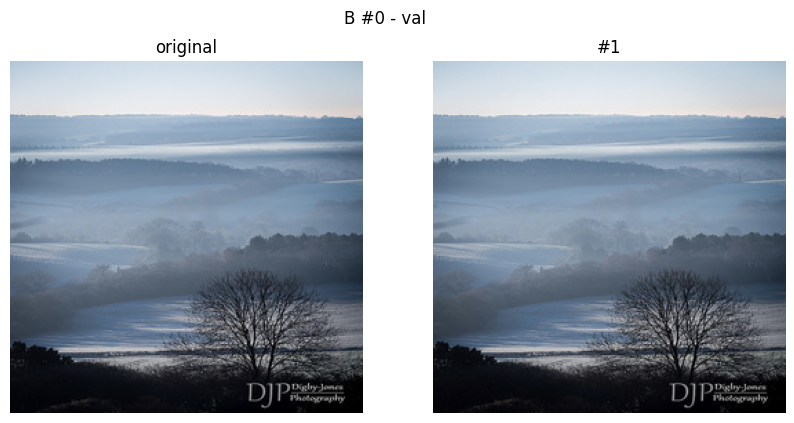

In [4]:
def get_transforms(mean, std, img_size=256, augment=True):
    """
    Возвращает train/val трансформы и функцию де-нормализации
    
    Args:
        mean (tuple): среднее по каналам (R, G, B)
        std (tuple): std по каналам (R, G, B)
        img_size (int): размер выходного изображения
        augment (bool): применять ли аугментации для train
    """
    # Базовые трансформы для валидации
    base_transform = [
        tr.Resize(img_size),
        tr.ToTensor(),
        tr.Normalize(mean=mean, std=std)
    ]
    
    # Аугментации для обучения
    if augment:
        train_transform = tr.Compose([
            tr.Resize(int(img_size * 1.12)),  # Случайное масштабирование
            tr.RandomCrop(img_size),
            tr.RandomHorizontalFlip(),
            *base_transform
        ])
    else:
        train_transform = tr.Compose(base_transform)
    
    # Трансформы для валидации/теста
    val_transform = tr.Compose(base_transform)
    
    # Функция для де-нормализации изображения
    def de_normalize(tensor):
        """Возвращает тензор в формате (C, H, W) к [0,1] диапазону"""
        inverse_mean = [-m/s for m, s in zip(mean, std)]
        inverse_std = [1/s for s in std]
        return tr.Normalize(mean=inverse_mean, std=inverse_std)(tensor.clone())
    
    return train_transform, val_transform, de_normalize


# Гиперпараметры трансформаций
hyperparams = dict(
    img_size=256,       # Размер изображения
    augment=True        # Использовать аугментации для обучения
)

# Трансформы для доменов A и B
train_transform_a, val_transform_a, de_normalize_a = get_transforms(
    mean=channel_mean_a, 
    std=channel_std_a, 
    **hyperparams
)
train_transform_b, val_transform_b, de_normalize_b = get_transforms(
    mean=channel_mean_b, 
    std=channel_std_b, 
    **hyperparams
)


def show_examples(dataset, transform, de_norm, num_per_image=3, image_index=0, title=""):
    """Визуализация оригинального и трансформированных изображений"""
    fig, ax = plt.subplots(1, 1 + num_per_image, figsize=(5*(1 + num_per_image), 5))
    
    # Получаем изображение из датасета
    image = dataset[image_index]
    
    # Конвертируем в PIL Image если это numpy array
    if isinstance(image, np.ndarray):
        image = Image.fromarray(image)
    elif isinstance(image, torch.Tensor):
        image = tr.ToPILImage()(image)
    
    plt.suptitle(title, y=0.95)

    # Оригинальное изображение
    plt.subplot(1, 1 + num_per_image, 1)
    plt.imshow(image)
    plt.title("original")
    plt.axis('off')

    # Трансформированные версии
    for i in range(num_per_image):
        plt.subplot(1, 1 + num_per_image, i + 2)
        
        # Применяем трансформации к PIL Image
        transformed = transform(image)
        
        # Де-нормализуем если это тензор
        if isinstance(transformed, torch.Tensor):
            transformed = de_norm(transformed)
            transformed = tr.ToPILImage()(transformed.clamp(0, 1))
        
        plt.imshow(transformed)
        plt.title(f"#{i+1}")
        plt.axis('off')
    plt.show()


# Проверка трансформаций
print("Domain A (summer):")
show_examples(ds.train_a, train_transform_a, de_normalize_a, num_per_image=4, image_index=0, title="A #0 - train")
show_examples(ds.train_a, val_transform_a, de_normalize_a, num_per_image=1, image_index=0, title="A #0 - val")

print("\nDomain B (winter):")
show_examples(ds.train_b, train_transform_b, de_normalize_b, num_per_image=4, image_index=0, title="B #0 - train")
show_examples(ds.train_b, val_transform_b, de_normalize_b, num_per_image=1, image_index=0, title="B #0 - val")

In [5]:
# Все датасеты с трансформами
ds = DatasetsClass(
    train_a=ImageDatasetNoLabel(
        os.path.join(target_folder, "trainA"),
        transform=train_transform_a,  # Аугментации для тренировочных данных домена A
    ),
    train_b=ImageDatasetNoLabel(
        os.path.join(target_folder, "trainB"),
        transform=train_transform_b,  # Аугментации для тренировочных данных домена B
    ),
    test_a=ImageDatasetNoLabel(
        os.path.join(target_folder, "testA"),
        transform=val_transform_a,  # Без аугментаций для тестовых данных
    ),
    test_b=ImageDatasetNoLabel(
        os.path.join(target_folder, "testB"),
        transform=val_transform_b,  # Без аугментаций для тестовых данных
    ),
)

# Проверка размеров датасетов
print(f"Train A size: {len(ds.train_a)} images")
print(f"Train B size: {len(ds.train_b)} images")
print(f"Test A size: {len(ds.test_a)} images")
print(f"Test B size: {len(ds.test_b)} images")

# Проверка одного примера из каждого датасета
def check_sample(dataset, name):
    sample = dataset[0]
    print(f"\n{name} sample:")
    print(f"Type: {type(sample)}")
    if isinstance(sample, torch.Tensor):
        print(f"Shape: {sample.shape}")
        print(f"Min: {sample.min().item():.3f}, Max: {sample.max().item():.3f}")
    elif isinstance(sample, np.ndarray):
        print(f"Shape: {sample.shape}")
        print(f"Min: {sample.min():.3f}, Max: {sample.max():.3f}")

check_sample(ds.train_a, "Train A")
check_sample(ds.train_b, "Train B")
check_sample(ds.test_a, "Test A")
check_sample(ds.test_b, "Test B")

Train A size: 400 images
Train B size: 6287 images
Test A size: 400 images
Test B size: 751 images

Train A sample:
Type: <class 'torch.Tensor'>
Shape: torch.Size([3, 256, 256])
Min: -2.115, Max: 2.721

Train B sample:
Type: <class 'torch.Tensor'>
Shape: torch.Size([3, 256, 256])
Min: -1.630, Max: 2.170

Test A sample:
Type: <class 'torch.Tensor'>
Shape: torch.Size([3, 256, 256])
Min: -2.149, Max: 2.874

Test B sample:
Type: <class 'torch.Tensor'>
Shape: torch.Size([3, 256, 256])
Min: -1.646, Max: 2.375


## 1.3 DataLoader

In [6]:
@dataclass
class DataLoadersClass:
    train_a: DataLoader
    train_b: DataLoader
    test_a: DataLoader
    test_b: DataLoader

# Гиперпараметры
batch_size = 4

# Функция для переноса батча на устройство
def transfer_to_device(batch, device):
    if isinstance(batch, torch.Tensor):
        return batch.to(device)
    elif isinstance(batch, (tuple, list)):
        return tuple(x.to(device) if isinstance(x, torch.Tensor) else x for x in batch)
    return batch

# Класс-обертка для автоматического переноса данных
class DeviceDataLoader:
    def __init__(self, dataloader, device):
        self.dataloader = dataloader
        self.device = device
        
    def __iter__(self):
        for batch in self.dataloader:
            yield transfer_to_device(batch, self.device)
            
    def __len__(self):
        return len(self.dataloader)

# Создаем базовые DataLoader'ы
base_dataloaders = DataLoadersClass(
    train_a=DataLoader(
        dataset=ds.train_a,
        batch_size=batch_size,
        shuffle=True,
        drop_last=True,
        num_workers=2,
        pin_memory=True  # Ускоряет перенос на GPU
    ),
    train_b=DataLoader(
        dataset=ds.train_b,
        batch_size=batch_size,
        shuffle=True,
        drop_last=True,
        num_workers=2,
        pin_memory=True
    ),
    test_a=DataLoader(
        dataset=ds.test_a,
        batch_size=batch_size,
        shuffle=False,
        drop_last=False,
        num_workers=2,
        pin_memory=True
    ),
    test_b=DataLoader(
        dataset=ds.test_b,
        batch_size=batch_size,
        shuffle=False,
        drop_last=False,
        num_workers=2,
        pin_memory=True
    ),
)

# Определяем устройство (GPU если доступно)
device = torch.device('cuda:0') if torch.cuda.is_available() else torch.device('cpu')

# Обертываем DataLoader'ы для автоматического переноса на устройство
dataloaders = DataLoadersClass(
    train_a=DeviceDataLoader(base_dataloaders.train_a, device),
    train_b=DeviceDataLoader(base_dataloaders.train_b, device),
    test_a=DeviceDataLoader(base_dataloaders.test_a, device),
    test_b=DeviceDataLoader(base_dataloaders.test_b, device)
)

# Проверка балансировки
print(f"Device: {device}")
print(f"Original sizes: TrainA={len(ds.train_a)}, TrainB={len(ds.train_b)}")
print(f"Effective batch sizes: TrainA={batch_size}, TrainB={batch_size}")
print(f"Train iterations per epoch: {len(dataloaders.train_a)}")

Device: cuda:0
Original sizes: TrainA=400, TrainB=6287
Effective batch sizes: TrainA=4, TrainB=4
Train iterations per epoch: 100


# 2. Модель (___6 баллов___)

## 2.0 Любые вспомогательные модули и классы

In [7]:
...

Ellipsis

## 2.1 Архитектура сети (___3 балла___)

In [8]:
class CycleGAN(nn.Module):
    def __init__(self, img_channels=3, features=64, residual_blocks=9):
        super(CycleGAN, self).__init__()
        
        # Генераторы (ResNet-based)
        self.gen_A2B = Generator(img_channels, features, residual_blocks)
        self.gen_B2A = Generator(img_channels, features, residual_blocks)
        
        # Дискриминаторы (PatchGAN)
        self.disc_A = Discriminator(img_channels, features)
        self.disc_B = Discriminator(img_channels, features)
        
        # Инициализация весов
        self.apply(self._init_weights)
    
    def _init_weights(self, m):
        if isinstance(m, nn.Conv2d):
            nn.init.normal_(m.weight, 0.0, 0.02)
            if m.bias is not None:
                nn.init.constant_(m.bias, 0)
        elif isinstance(m, nn.InstanceNorm2d):
            if m.weight is not None:  # Добавляем проверку на None
                nn.init.constant_(m.weight, 1.0)
            if m.bias is not None:    # Добавляем проверку на None
                nn.init.constant_(m.bias, 0)
    
    def forward(self, x_A, x_B):
        # Прямой перевод
        fake_B = self.gen_A2B(x_A)
        fake_A = self.gen_B2A(x_B)
        
        # Циклическая согласованность
        cycled_A = self.gen_B2A(fake_B)
        cycled_B = self.gen_A2B(fake_A)
        
        # Identity mapping (для сохранения цветов)
        same_A = self.gen_B2A(x_A)
        same_B = self.gen_A2B(x_B)
        
        # Дискриминация
        disc_real_A = self.disc_A(x_A)
        disc_real_B = self.disc_B(x_B)
        disc_fake_A = self.disc_A(fake_A)
        disc_fake_B = self.disc_B(fake_B)
        
        return {
            'fake_A': fake_A,
            'fake_B': fake_B,
            'cycled_A': cycled_A,
            'cycled_B': cycled_B,
            'same_A': same_A,
            'same_B': same_B,
            'disc_real_A': disc_real_A,
            'disc_real_B': disc_real_B,
            'disc_fake_A': disc_fake_A,
            'disc_fake_B': disc_fake_B
        }


class Generator(nn.Module):
    """ResNet-based генератор с 9 residual блоками"""
    def __init__(self, img_channels, features, num_residuals):
        super(Generator, self).__init__()
        
        # Initial convolution
        layers = [
            nn.ReflectionPad2d(3),
            nn.Conv2d(img_channels, features, 7),
            nn.InstanceNorm2d(features),
            nn.ReLU(inplace=True)
        ]
        
        # Downsampling
        in_features = features
        out_features = features*2
        for _ in range(2):
            layers += [
                nn.Conv2d(in_features, out_features, 3, stride=2, padding=1),
                nn.InstanceNorm2d(out_features),
                nn.ReLU(inplace=True)
            ]
            in_features = out_features
            out_features = in_features*2
        
        # Residual blocks
        for _ in range(num_residuals):
            layers += [ResidualBlock(in_features)]
        
        # Upsampling
        out_features = in_features//2
        for _ in range(2):
            layers += [
                nn.ConvTranspose2d(in_features, out_features, 3, stride=2, padding=1, output_padding=1),
                nn.InstanceNorm2d(out_features),
                nn.ReLU(inplace=True)
            ]
            in_features = out_features
            out_features = in_features//2
        
        # Output layer
        layers += [
            nn.ReflectionPad2d(3),
            nn.Conv2d(features, img_channels, 7),
            nn.Tanh()
        ]
        
        self.model = nn.Sequential(*layers)
    
    def forward(self, x):
        return self.model(x)


class ResidualBlock(nn.Module):
    """Residual блок с instance normalization"""
    def __init__(self, features):
        super(ResidualBlock, self).__init__()
        
        self.block = nn.Sequential(
            nn.ReflectionPad2d(1),
            nn.Conv2d(features, features, 3),
            nn.InstanceNorm2d(features),
            nn.ReLU(inplace=True),
            nn.ReflectionPad2d(1),
            nn.Conv2d(features, features, 3),
            nn.InstanceNorm2d(features)
        )
    
    def forward(self, x):
        return x + self.block(x)


class Discriminator(nn.Module):
    """PatchGAN дискриминатор"""
    def __init__(self, img_channels, features):
        super(Discriminator, self).__init__()
        
        layers = []
        # Initial layer
        layers += [
            nn.Conv2d(img_channels, features, 4, stride=2, padding=1),
            nn.LeakyReLU(0.2, inplace=True)
        ]
        
        # Downsampling
        in_features = features
        for i in range(3):
            out_features = min(in_features*2, 512)
            layers += [
                nn.Conv2d(in_features, out_features, 4, stride=2, padding=1),
                nn.InstanceNorm2d(out_features),
                nn.LeakyReLU(0.2, inplace=True)
            ]
            in_features = out_features
        
        # Output layer
        layers += [
            nn.Conv2d(in_features, 1, 4, stride=1, padding=1),
            # No sigmoid - используем LSGAN
        ]
        
        self.model = nn.Sequential(*layers)
    
    def forward(self, x):
        return self.model(x)

## 2.2 Loss (___3 балла___)

$$ \mathbf{L}_{\text{cyc}} \big( G_{A \rightarrow B}, G_{B \rightarrow A} \big) = \mathbb{E}_{a \sim A} \bigg( \Big\| G_{B \rightarrow A} \big( G_{A \rightarrow B} ( a ) \big) - a \Big\|_1 \bigg) + \mathbb{E}_{b \sim B} \bigg( \Big\| G_{A \rightarrow B} \big( G_{B \rightarrow A} ( b ) \big) - b \Big\|_1 \bigg) \longrightarrow \min_{G}$$

In [9]:
class CycleConsistencyLoss(nn.Module):
    def __init__(self, lambda_cyc=10.0, reduction='mean'):
        super(CycleConsistencyLoss, self).__init__()
        self.lambda_cyc = lambda_cyc  # Коэффициент важности циклического лосса
        self.criterion = nn.L1Loss(reduction=reduction)
    
    def forward(self, real_A, cycled_A, real_B, cycled_B):
        loss_A = self.criterion(cycled_A, real_A)
        loss_B = self.criterion(cycled_B, real_B)
        total_loss = (loss_A + loss_B) * self.lambda_cyc
        return total_loss

$$ \mathbf{L}_{\text{GAN}} \big( G_{A \rightarrow B}, D_{B} \big) = \mathbb{E}_{b \sim B} \log D_{B} (b) + \mathbb{E}_{a \sim A} \log \Big( 1 - D_{B} \big( G_{A \rightarrow B} (a) \big) \Big) \longrightarrow \min_{G} \max_{D}$$

In [10]:
class AdversarialLossCE(nn.Module):
    def __init__(self, target_real_label=1.0, target_fake_label=0.0):
        super(AdversarialLossCE, self).__init__()
        self.register_buffer('real_label', torch.tensor(target_real_label))
        self.register_buffer('fake_label', torch.tensor(target_fake_label))
        self.loss = nn.BCEWithLogitsLoss()
    
    def forward(self, prediction, target_is_real):
        if target_is_real:
            target_tensor = self.real_label
        else:
            target_tensor = self.fake_label
        
        target_tensor = target_tensor.expand_as(prediction)
        return self.loss(prediction, target_tensor)

$$ \mathbb{E}_{b \sim B} \big( D_{B} (b) - 1 \big)^2 + \mathbb{E}_{a \sim A} \Big( D_{B} \big( G_{A \rightarrow B} (a) \big) \Big)^2 \longrightarrow \min_{D} $$
$$ \mathbb{E}_{a \sim A} \Big( D_{B} \big( G_{A \rightarrow B} (a) \big) - 1 \Big)^2 \longrightarrow \min_{G} $$

In [11]:
class AdversarialLossMSE(nn.Module):
    def __init__(self, target_real_label=1.0, target_fake_label=0.0):
        super(AdversarialLossMSE, self).__init__()
        self.register_buffer('real_label', torch.tensor(target_real_label))
        self.register_buffer('fake_label', torch.tensor(target_fake_label))
        self.loss = nn.MSELoss()
    
    def forward(self, prediction, target_is_real):
        if target_is_real:
            target_tensor = self.real_label.expand_as(prediction).to(prediction.device)
        else:
            target_tensor = self.fake_label.expand_as(prediction).to(prediction.device)
        return self.loss(prediction, target_tensor)

$$ \mathbf{L} \big( G_{A \rightarrow B}, G_{B \rightarrow A}, D_{A}, D_{B} \big) = \mathbf{L}_{\text{GAN}} \big( G_{A \rightarrow B}, D_{B} \big) + \mathbf{L}_{\text{GAN}} \big( G_{B \rightarrow A}, D_{A} \big) + \lambda \cdot \mathbf{L}_{\text{cyc}} \big( G_{A \rightarrow B}, G_{B \rightarrow A} \big) \longrightarrow \min_{G} \max_{D}$$

In [12]:
class FullDiscriminatorLoss(nn.Module):
    def __init__(self, is_mse=True):
        super(FullDiscriminatorLoss, self).__init__()
        self.adversarial_loss = AdversarialLossMSE() if is_mse else AdversarialLossCE()
    
    def forward(self, disc_real_A, disc_fake_A, disc_real_B, disc_fake_B):
        # Измененный вызов для совместимости
        loss_D_A = self.adversarial_loss(disc_real_A, True) + self.adversarial_loss(disc_fake_A, False)
        loss_D_B = self.adversarial_loss(disc_real_B, True) + self.adversarial_loss(disc_fake_B, False)
        
        return (loss_D_A + loss_D_B) / 2  # Среднее значение

In [13]:
class FullGeneratorLoss(nn.Module):
    def __init__(self, lambda_cyc=10., lambda_idt=0.5, is_mse=True):
        super(FullGeneratorLoss, self).__init__()
        self.lambda_cyc = lambda_cyc
        self.lambda_idt = lambda_idt
        self.adversarial_loss = AdversarialLossMSE() if is_mse else AdversarialLossCE()
        self.cycle_loss = CycleConsistencyLoss()
        self.idt_loss = nn.L1Loss()

    def forward(self, fake_A, cycled_A, real_A, fake_B, cycled_B, real_B, 
               disc_fake_A, disc_fake_B, same_A=None, same_B=None):
        # Adversarial losses (генератор хочет обмануть дискриминатор)
        loss_gan_A = self.adversarial_loss(disc_fake_A, target_is_real=True)
        loss_gan_B = self.adversarial_loss(disc_fake_B, target_is_real=True)
        
        # Cycle consistency loss
        loss_cyc = self.cycle_loss(real_A, cycled_A, real_B, cycled_B)
        
        # Identity loss (опционально)
        loss_idt = 0
        if same_A is not None and same_B is not None:
            loss_idt = self.idt_loss(same_A, real_A) + self.idt_loss(same_B, real_B)
        
        # Total loss
        total_loss = (loss_gan_A + loss_gan_B + 
                     self.lambda_cyc * loss_cyc)
                
        return total_loss, {
            'loss_GAN': loss_gan_A + loss_gan_B,
            'loss_cyc': loss_cyc,
            'loss_idt': loss_idt,
            'loss_GAN_A': loss_gan_A,
            'loss_GAN_B': loss_gan_B
        }

# 3. Подготовка обучения (__2 балла__)

## 3.1 Шаг обучения дискриминатора

In [14]:
def train_discriminators(model, opt_d, loader_a, loader_b, criterion_d):
    model.train()
    losses_tr = []
    
    iter_a = iter(loader_a)
    iter_b = iter(loader_b)
    batches_per_epoch = min(len(loader_a), len(loader_b))
    
    for _ in trange(batches_per_epoch, desc="Training Discriminators"):
        # Явно переносим данные на устройство модели
        real_a = next(iter_a).to(next(model.parameters()).device)
        real_b = next(iter_b).to(next(model.parameters()).device)
        
        # Генерация фейков
        with torch.no_grad():
            fake_b = model.gen_A2B(real_a)
            fake_a = model.gen_B2A(real_b)
        
        opt_d.zero_grad()
        
        # Дискриминация
        disc_real_a = model.disc_A(real_a)
        disc_fake_a = model.disc_A(fake_a.detach())
        disc_real_b = model.disc_B(real_b)
        disc_fake_b = model.disc_B(fake_b.detach())
        
        # Лосс
        loss = criterion_d(disc_real_a, disc_fake_a, disc_real_b, disc_fake_b)
        
        loss.backward()
        opt_d.step()
        losses_tr.append(loss.item())
    
    return model, opt_d, np.mean(losses_tr)

## 3.2 Шаг обучения генератора

In [15]:
def train_generators(model, opt_g, loader_a, loader_b, criterion_g):
    model.train()
    losses_tr = []
    loss_components = {
        'gan': [],
        'cycle': [],
        'identity': []
    }
    
    iter_a = iter(loader_a)
    iter_b = iter(loader_b)
    batches_per_epoch = min(len(loader_a), len(loader_b))
    
    for _ in trange(batches_per_epoch, desc="Training Generators"):
        # Загрузка реальных изображений
        real_a = next(iter_a).to(device)
        real_b = next(iter_b).to(device)
        
        # Генерация изображений
        fake_b = model.gen_A2B(real_a)
        fake_a = model.gen_B2A(real_b)
        
        # Циклическая реконструкция
        cycled_a = model.gen_B2A(fake_b)
        cycled_b = model.gen_A2B(fake_a)
        
        # Identity mapping (опционально)
        same_a = model.gen_B2A(real_a)
        same_b = model.gen_A2B(real_b)
        
        # Прямой проход через дискриминаторы
        disc_fake_a = model.disc_A(fake_a)
        disc_fake_b = model.disc_B(fake_b)
        
        # Обнуление градиентов
        opt_g.zero_grad()
        
        # Вычисление лосса
        total_loss, loss_dict = criterion_g(
            fake_A=fake_a,
            cycled_A=cycled_a,
            real_A=real_a,
            fake_B=fake_b,
            cycled_B=cycled_b,
            real_B=real_b,
            disc_fake_A=disc_fake_a,
            disc_fake_B=disc_fake_b,
            same_A=same_a,  # Можно исключить, если не используется identity loss
            same_B=same_b    # Можно исключить, если не используется identity loss
        )
        
        # Обратное распространение
        total_loss.backward()
        opt_g.step()
        
        # Сохранение лоссов для логирования
        losses_tr.append(total_loss.item())
        loss_components['gan'].append(loss_dict['loss_GAN'].item())
        loss_components['cycle'].append(loss_dict['loss_cyc'].item())
        if 'loss_idt' in loss_dict:
            loss_components['identity'].append(loss_dict['loss_idt'].item())
    
    # Сбор статистики
    avg_losses = {
        'total': np.mean(losses_tr),
        'gan': np.mean(loss_components['gan']),
        'cycle': np.mean(loss_components['cycle'])
    }
    if loss_components['identity']:
        avg_losses['identity'] = np.mean(loss_components['identity'])
    
    return model, opt_g, avg_losses


## 3.3 Шаг валидации

In [16]:
from collections import defaultdict

def validate(model, loader_a, loader_b, criterion_d, criterion_g):
    model.eval()
    val_data = defaultdict(list)

    with torch.no_grad():
        iter_a = iter(loader_a)
        iter_b = iter(loader_b)
        batches_per_epoch = min(len(loader_a), len(loader_b))

        for _ in trange(batches_per_epoch, desc="Validation"):
            # Загрузка данных
            real_a = next(iter_a).to(device)
            real_b = next(iter_b).to(device)
            
            # Генерация изображений
            fake_b = model.gen_A2B(real_a)
            fake_a = model.gen_B2A(real_b)
            
            # Циклическая реконструкция
            cycled_a = model.gen_B2A(fake_b)
            cycled_b = model.gen_A2B(fake_a)
            
            # Identity mapping (опционально)
            same_a = model.gen_B2A(real_a)
            same_b = model.gen_A2B(real_b)
            
            # Предикты дискриминаторов
            a_real_pred = model.disc_A(real_a)
            a_fake_pred = model.disc_A(fake_a)
            b_real_pred = model.disc_B(real_b)
            b_fake_pred = model.disc_B(fake_b)
            
            # Вычисление лоссов
            loss_d = criterion_d(
                disc_real_A=a_real_pred,
                disc_fake_A=a_fake_pred,
                disc_real_B=b_real_pred,
                disc_fake_B=b_fake_pred
            )
            
            loss_g, loss_g_components = criterion_g(
                fake_A=fake_a,
                cycled_A=cycled_a,
                real_A=real_a,
                fake_B=fake_b,
                cycled_B=cycled_b,
                real_B=real_b,
                disc_fake_A=a_fake_pred,
                disc_fake_B=b_fake_pred,
                same_A=same_a,
                same_B=same_b
            )
            
            # Сохранение лоссов
            val_data["loss D"].append(loss_d.item())
            val_data["loss G"].append(loss_g.item())
            for k, v in loss_g_components.items():
                val_data[f"G_{k}"].append(v.item())
            
            # Обработка предиктов для логирования
            is_mse_pred = len(a_real_pred.shape) == 1 or a_real_pred.shape[-1] == 1  # Более надежная проверка
            
            if is_mse_pred:
                # Для MSE loss просто берем значения
                a_real_pred = a_real_pred.squeeze().float()
                b_real_pred = b_real_pred.squeeze().float()
                a_fake_pred = a_fake_pred.squeeze().float()
                b_fake_pred = b_fake_pred.squeeze().float()
            else:
                # Для CE loss с двумя классами берем вероятность второго класса
                a_real_pred = F.sigmoid(a_real_pred).squeeze().float()  # Или softmax если действительно 2 класса
                b_real_pred = F.sigmoid(b_real_pred).squeeze().float()
                a_fake_pred = F.sigmoid(a_fake_pred).squeeze().float()
                b_fake_pred = F.sigmoid(b_fake_pred).squeeze().float()
            
            # Сохранение предиктов
            val_data["real pred A"].extend(a_real_pred.cpu().tolist())
            val_data["real pred B"].extend(b_real_pred.cpu().tolist())
            val_data["fake pred A"].extend(a_fake_pred.cpu().tolist())
            val_data["fake pred B"].extend(b_fake_pred.cpu().tolist())
        
        # Усреднение лоссов
        for k in list(val_data.keys()):
            if k.startswith(('loss', 'G_')):
                val_data[k] = np.mean(val_data[k])
    
    return val_data

## 3.4 Визуализация сгенерированного

In [17]:
def draw_imgs(model, num_images, loader_a, loader_b, de_norm_a, de_norm_b):
    model.eval()
    with torch.no_grad():
        try:
            # Получаем батч изображений
            batch_a = next(iter(loader_a))
            batch_b = next(iter(loader_b))
            
            # Извлекаем изображения (если данные в формате (x,y))
            imgs_a = batch_a[0] if isinstance(batch_a, (tuple, list)) else batch_a
            imgs_b = batch_b[0] if isinstance(batch_b, (tuple, list)) else batch_b
            
            # Берем нужное количество изображений
            imgs_a = imgs_a[:num_images].to(device)
            imgs_b = imgs_b[:num_images].to(device)
            
            # Генерация изображений
            fake_b = model.gen_A2B(imgs_a)
            fake_a = model.gen_B2A(imgs_b)
            
            # Функция подготовки изображений
            def prepare_images(images, de_norm):
                images = images.detach().cpu()
                
                # Денормализация (оставляем как torch.Tensor)
                result = []
                for img in images:
                    try:
                        denorm_img = de_norm(img)
                    except TypeError:
                        denorm_img = de_norm(img, normalized=True)
                    
                    # Преобразуем в numpy и меняем порядок размерностей (C,H,W) -> (H,W,C)
                    denorm_img = denorm_img.permute(1, 2, 0).numpy()
                    # Обрезаем значения для matplotlib
                    denorm_img = np.clip(denorm_img, 0, 1)
                    result.append(denorm_img)
                return result
            
            # Подготовка изображений
            imgs_a = prepare_images(imgs_a, de_norm_a)
            imgs_b = prepare_images(imgs_b, de_norm_b)
            fake_a = prepare_images(fake_a, de_norm_a)
            fake_b = prepare_images(fake_b, de_norm_b)
            
            # Визуализация
            fig, axes = plt.subplots(2, num_images, figsize=(15, 6))
            plt.suptitle("Image Translations", y=1.05)
            
            for i in range(num_images):
                # Domain A -> B
                ax = axes[0, i] if num_images > 1 else axes[0]
                ax.imshow(imgs_a[i])
                ax.set_title("Original A" if i == 0 else "")
                ax.axis('off')
                
                ax = axes[1, i] if num_images > 1 else axes[1]
                ax.imshow(fake_b[i])
                ax.set_title("A → B" if i == 0 else "")
                ax.axis('off')
            
            plt.tight_layout()
            plt.show()
            
            # Вторая пара изображений
            fig, axes = plt.subplots(2, num_images, figsize=(15, 6))
            
            for i in range(num_images):
                # Domain B -> A
                ax = axes[0, i] if num_images > 1 else axes[0]
                ax.imshow(imgs_b[i])
                ax.set_title("Original B" if i == 0 else "")
                ax.axis('off')
                
                ax = axes[1, i] if num_images > 1 else axes[1]
                ax.imshow(fake_a[i])
                ax.set_title("B → A" if i == 0 else "")
                ax.axis('off')
            
            plt.tight_layout()
            plt.show()
            
        except Exception as e:
            print(f"[ERROR] in draw_imgs: {str(e)}")
            plt.close('all')

## 3.5 Цикл обучения

In [18]:
from IPython.display import clear_output
import warnings
import os
import numpy as np
import matplotlib.pyplot as plt
import torch

def get_model_name(chkp_folder, model_name=None):
    """Генерирует уникальное имя для сохранения модели"""
    if model_name is None:
        if os.path.exists(chkp_folder):
            existing_files = [f for f in os.listdir(chkp_folder) if f.endswith('.pt')]
            num_starts = len(existing_files) + 1
        else:
            num_starts = 1
        model_name = f'model_{num_starts}'
    elif '#' not in model_name:
        model_name = f'{model_name}_1'
    
    counter = 1
    original_name = model_name
    while os.path.exists(os.path.join(chkp_folder, f'{model_name}.pt')):
        model_name = f'{original_name}_{counter}'
        counter += 1
    
    return model_name

def get_lr(optimizer):
    """Получает текущий learning rate из оптимизатора"""
    for param_group in optimizer.param_groups:
        return param_group['lr']

def learning_loop(
    model,
    optimizer_g,
    g_iters_per_epoch,
    optimizer_d,
    d_iters_per_epoch,
    train_loader_a,
    train_loader_b,
    val_loader_a,
    val_loader_b,
    criterion_d,
    criterion_g,
    de_norm_a,
    de_norm_b,
    scheduler_d=None,
    scheduler_g=None,
    min_lr=None,
    epochs=10,
    val_every=1,
    draw_every=1,
    model_name=None,
    chkp_folder="./chkps",
    images_per_validation=3,
    plots=None,
    starting_epoch=0,
):
    # Инициализация имени модели и папки для чекпоинтов
    model_name = get_model_name(chkp_folder, model_name)
    os.makedirs(chkp_folder, exist_ok=True)
    
    if plots is None:
        plots = {
            'train G': [],  # Будем хранить только числа
            'train D': [],  # Будем хранить только числа
            'val D': [],
            'val G': [],
            "lr G": [],
            "lr D": [],
            "hist real A": [],
            "hist gen A": [],
            "hist real B": [],
            "hist gen B": [],
        }

    for epoch in range(starting_epoch, starting_epoch + epochs):
        print(f'Epoch {epoch+1}/{starting_epoch + epochs}')
        model.train()
        
        # Обновляем learning rate в логах
        plots['lr G'].append(get_lr(optimizer_g))
        plots['lr D'].append(get_lr(optimizer_d))
        
        # Обучение дискриминаторов (ИЗМЕНЕНИЕ ТУТ)
        print("Training discriminators...")
        d_losses = []
        for _ in range(d_iters_per_epoch):
            model, optimizer_d, loss_dict = train_discriminators(
                model, optimizer_d, train_loader_a, train_loader_b, criterion_d)
            # Берем только значение total loss, если возвращается словарь
            loss_value = loss_dict['total'] if isinstance(loss_dict, dict) else loss_dict
            d_losses.append(float(loss_value))  # Явное преобразование в float
        
        plots['train D'].extend(d_losses)
        
        # Обучение генераторов (ИЗМЕНЕНИЕ ТУТ)
        print("Training generators...")
        g_losses = []
        for _ in range(g_iters_per_epoch):
            model, optimizer_g, loss_dict = train_generators(
                model, optimizer_g, train_loader_a, train_loader_b, criterion_g)
            # Берем только значение total loss, если возвращается словарь
            loss_value = loss_dict['total'] if isinstance(loss_dict, dict) else loss_dict
            g_losses.append(float(loss_value))  # Явное преобразование в float
        
        plots['train G'].extend(g_losses)

        # Валидация (ИЗМЕНЕНИЕ ТУТ)
        if (epoch + 1) % val_every == 0:
            print("Validating...")
            val_data = validate(model, val_loader_a, val_loader_b, criterion_d, criterion_g)
            
            # Явное преобразование в float
            plots['val D'].append(float(val_data["loss D"]))
            plots['val G'].append(float(val_data["loss G"]))
            plots['hist real A'].append(val_data["real pred A"])
            plots['hist gen A'].append(val_data["fake pred A"])
            plots['hist real B'].append(val_data["real pred B"])
            plots['hist gen B'].append(val_data["fake pred B"])
            
            # Сохраняем чекпоинт
            if epoch % 5 == 0:
                torch.save({
                    'epoch': epoch,
                    'model_state_dict': model.state_dict(),
                    'optimizer_d_state_dict': optimizer_d.state_dict(),
                    'optimizer_g_state_dict': optimizer_g.state_dict(),
                    'scheduler_d_state_dict': scheduler_d.state_dict() if scheduler_d else None,
                    'scheduler_g_state_dict': scheduler_g.state_dict() if scheduler_g else None,
                    'plots': plots,
                }, os.path.join(chkp_folder, f'{model_name}_epoch_{epoch}.pt'))
            
            # Обновляем шедулеры
            if scheduler_d:
                scheduler_d.step(val_data["loss D"])
            if scheduler_g:
                scheduler_g.step(val_data["loss G"])

        # Визуализация (ОСТАЕТСЯ БЕЗ ИЗМЕНЕНИЙ)
        if (epoch + 1) % draw_every == 0:
            clear_output(wait=True)
            
            # Создаем графики
            fig, axes = plt.subplots(2, 2, figsize=(20, 15))
            fig.suptitle(f'Epoch {epoch+1}/{starting_epoch + epochs}', fontsize=16)
            
            # График лосса дискриминаторов
            ax = axes[0, 0]
            ax.set_title('Discriminator Loss')
            d_plot_step = 1. / d_iters_per_epoch
            x_vals = np.arange(d_plot_step, len(plots['train D']) * d_plot_step + d_plot_step, d_plot_step)
            ax.plot(x_vals[:len(plots['train D'])], plots['train D'], 'r-', label='Train')
            ax.plot(np.arange(1, len(plots['val D']) + 1), plots['val D'], 'g-', label='Validation')
            ax.set_xlabel('Epochs')
            ax.set_ylabel('Loss')
            ax.legend()
            ax.grid(True)
            
            # График лосса генераторов
            ax = axes[0, 1]
            ax.set_title('Generator Loss')
            g_plot_step = 1. / g_iters_per_epoch
            x_vals = np.arange(g_plot_step, len(plots['train G']) * g_plot_step + g_plot_step, g_plot_step)
            ax.plot(x_vals[:len(plots['train G'])], plots['train G'], 'r-', label='Train')
            ax.plot(np.arange(1, len(plots['val G']) + 1), plots['val G'], 'g-', label='Validation')
            ax.set_xlabel('Epochs')
            ax.set_ylabel('Loss')
            ax.legend()
            ax.grid(True)
            
            # Гистограммы предсказаний дискриминатора A
            ax = axes[1, 0]
            ax.set_title('Discriminator A Predictions')
            try:
                real_a_flat = np.concatenate([np.array(x).flatten() for x in plots['hist real A'][-1]])
                fake_a_flat = np.concatenate([np.array(x).flatten() for x in plots['hist gen A'][-1]])
                ax.hist(real_a_flat, bins=50, alpha=0.5, density=True, label='Real')
                ax.hist(fake_a_flat, bins=50, alpha=0.5, density=True, label='Fake')
            except Exception as e:
                print(f"Error plotting A histograms: {str(e)}")
            ax.set_xlabel('Prediction Score')
            ax.set_ylabel('Density')
            ax.legend()

            # Гистограммы предсказаний дискриминатора B
            ax = axes[1, 1]
            ax.set_title('Discriminator B Predictions')
            try:
                real_b_flat = np.concatenate([np.array(x).flatten() for x in plots['hist real B'][-1]])
                fake_b_flat = np.concatenate([np.array(x).flatten() for x in plots['hist gen B'][-1]])
                ax.hist(real_b_flat, bins=50, alpha=0.5, density=True, label='Real')
                ax.hist(fake_b_flat, bins=50, alpha=0.5, density=True, label='Fake')
            except Exception as e:
                print(f"Error plotting B histograms: {str(e)}")
            ax.set_xlabel('Prediction Score')
            ax.set_ylabel('Density')
            ax.legend()
            
            plt.tight_layout()
            plt.show()
            
            # Визуализация примеров
            draw_imgs(model, images_per_validation, val_loader_a, val_loader_b, de_norm_a, de_norm_b)
        
        # Проверка early stopping по learning rate
        current_lr_d = get_lr(optimizer_d)
        current_lr_g = get_lr(optimizer_g)
        
        if min_lr and current_lr_d <= min_lr:
            print(f'Early stopping: discriminator LR ({current_lr_d:.2e}) <= min_lr ({min_lr:.2e})')
            break
            
        if min_lr and current_lr_g <= min_lr:
            print(f'Early stopping: generator LR ({current_lr_g:.2e}) <= min_lr ({min_lr:.2e})')
            break
    
    # Сохраняем финальную модель
    torch.save({
        'epoch': epoch,
        'model_state_dict': model.state_dict(),
        'optimizer_d_state_dict': optimizer_d.state_dict(),
        'optimizer_g_state_dict': optimizer_g.state_dict(),
        'scheduler_d_state_dict': scheduler_d.state_dict() if scheduler_d else None,
        'scheduler_g_state_dict': scheduler_g.state_dict() if scheduler_g else None,
        'plots': plots,
    }, os.path.join(chkp_folder, f'{model_name}_final.pt'))
    
    return model, optimizer_d, optimizer_g, plots

# 4. Обучение (___2 балла___)

## 4.1 Инициализация модели и оптимайзера

In [19]:
from collections import defaultdict
from termcolor import colored


def beautiful_int(i):
    i = str(i)
    return ".".join(reversed([i[max(j, 0):j+3] for j in range(len(i) - 3, -3, -3)]))


# Подсчёт числа параметров в нашей модели
def model_num_params(model, verbose_all=True, verbose_only_learnable=False):
    sum_params = 0
    sum_learnable_params = 0
    submodules = defaultdict(lambda : [0, 0])
    for name, param in model.named_parameters():
        num_params = param.numel()
        if verbose_all or (verbose_only_learnable and param.requires_grad):
            print(
                colored(
                    '{: <65} ~  {: <9} params ~ grad: {}'.format(
                        name,
                        beautiful_int(num_params),
                        param.requires_grad,
                    ),
                    {True: "green", False: "red"}[param.requires_grad],
                )
            )
        sum_params += num_params
        sm = name.split(".")[0]
        submodules[sm][0] += num_params
        if param.requires_grad:
            sum_learnable_params += num_params
            submodules[sm][1] += num_params
    print(
        f'\nIn total:\n  - {beautiful_int(sum_params)} params\n  - {beautiful_int(sum_learnable_params)} learnable params'
    )
    
    for sm, v in submodules.items():
        print(
            f"\n . {sm}:\n .   - {beautiful_int(submodules[sm][0])} params\n .   - {beautiful_int(submodules[sm][1])} learnable params"
        )
    return sum_params, sum_learnable_params

In [20]:
device = torch.device('cuda:0') if torch.cuda.is_available() else torch.device('cpu')

def create_model_and_optimizer(model_class, model_params, lr=2e-4, betas=(0.5, 0.999), device=device):
    """
    Инициализирует модель CycleGAN и оптимизаторы
    
    Args:
        model_class: класс модели (CycleGAN)
        model_params: параметры для инициализации модели
        lr: learning rate (по умолчанию 0.0002)
        betas: коэффициенты для Adam (по умолчанию (0.5, 0.999))
        device: устройство (CPU/GPU)
    
    Returns:
        model: инициализированная модель на нужном устройстве
        optimizer_d: оптимизатор для дискриминаторов
        optimizer_g: оптимизатор для генераторов
    """
    # Инициализация модели
    model = model_class(**model_params).to(device)
    
    # Разделение параметров для оптимизаторов
    generator_params = list(model.gen_A2B.parameters()) + list(model.gen_B2A.parameters())
    discriminator_params = list(model.disc_A.parameters()) + list(model.disc_B.parameters())
    
    # Оптимизаторы (Adam как в оригинальной статье)
    optimizer_g = torch.optim.Adam(
        generator_params,
        lr=lr,
        betas=betas
    )
    
    optimizer_d = torch.optim.Adam(
        discriminator_params,
        lr=lr,
        betas=betas
    )
    
    # Вывод информации о модели
    print("Model architecture:")
    print(model)
    print("\nModel parameters:")
    total_params, learnable_params = model_num_params(model, verbose_all=False, verbose_only_learnable=True)
    
    print("\nOptimizers configuration:")
    print(f"Generator optimizer: {optimizer_g}")
    print(f"Discriminator optimizer: {optimizer_d}")
    print(f"Learning rate: {lr}")
    print(f"Betas: {betas}")
    
    return model, optimizer_d, optimizer_g

## 4.2 Фактическое обучение

In [21]:
# Инициализация устройства
device = torch.device('cuda:0') if torch.cuda.is_available() else torch.device('cpu')
print(f"Using device: {device}")

# Параметры модели
model_params = {
    'img_channels': 3,          # RGB изображения
    'features': 64,             # Число каналов в первом слое
    'residual_blocks': 9        # Количество residual блоков в генераторе
}

# Создаем модель и оптимизаторы
model, optimizer_d, optimizer_g = create_model_and_optimizer(
    model_class=CycleGAN,
    model_params=model_params,
    lr=2e-4,                    # Learning rate из оригинальной статьи
    betas=(0.5, 0.999),         # Параметры для Adam
    device=device
)

# Шедулеры для регулировки learning rate
scheduler_d = torch.optim.lr_scheduler.LambdaLR(
    optimizer_d,
    lr_lambda=lambda epoch: 1.0 - max(0, epoch - 100) / 100.0  # Linear decay после 100 эпох
)

scheduler_g = torch.optim.lr_scheduler.LambdaLR(
    optimizer_g,
    lr_lambda=lambda epoch: 1.0 - max(0, epoch - 100) / 100.0
)

# Функции потерь
criterion_d = FullDiscriminatorLoss(is_mse=True)  # Используем MSE loss для стабильности
criterion_g = FullGeneratorLoss(
    lambda_cyc=10.0,            # Вес cycle consistency loss (из статьи)
    is_mse=True                 # Согласованность с дискриминатором
)

sum_params, sum_learnable_params = model_num_params(model, verbose_all=False)

Using device: cuda:0
Model architecture:
CycleGAN(
  (gen_A2B): Generator(
    (model): Sequential(
      (0): ReflectionPad2d((3, 3, 3, 3))
      (1): Conv2d(3, 64, kernel_size=(7, 7), stride=(1, 1))
      (2): InstanceNorm2d(64, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
      (3): ReLU(inplace=True)
      (4): Conv2d(64, 128, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
      (5): InstanceNorm2d(128, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
      (6): ReLU(inplace=True)
      (7): Conv2d(128, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
      (8): InstanceNorm2d(256, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
      (9): ReLU(inplace=True)
      (10): ResidualBlock(
        (block): Sequential(
          (0): ReflectionPad2d((1, 1, 1, 1))
          (1): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1))
          (2): InstanceNorm2d(256, eps=1e-05, momentum=0.1, affine=False, track_running_stats=

In [22]:
model

CycleGAN(
  (gen_A2B): Generator(
    (model): Sequential(
      (0): ReflectionPad2d((3, 3, 3, 3))
      (1): Conv2d(3, 64, kernel_size=(7, 7), stride=(1, 1))
      (2): InstanceNorm2d(64, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
      (3): ReLU(inplace=True)
      (4): Conv2d(64, 128, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
      (5): InstanceNorm2d(128, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
      (6): ReLU(inplace=True)
      (7): Conv2d(128, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
      (8): InstanceNorm2d(256, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
      (9): ReLU(inplace=True)
      (10): ResidualBlock(
        (block): Sequential(
          (0): ReflectionPad2d((1, 1, 1, 1))
          (1): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1))
          (2): InstanceNorm2d(256, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
          (3): ReLU(inplace=True)


In [23]:
# Перед обучением проверяем устройство модели
print(f"Model device: {next(model.parameters()).device}")
print(f"Data loader device: {next(iter(dataloaders.train_a))[0].device}")

Model device: cuda:0
Data loader device: cuda:0


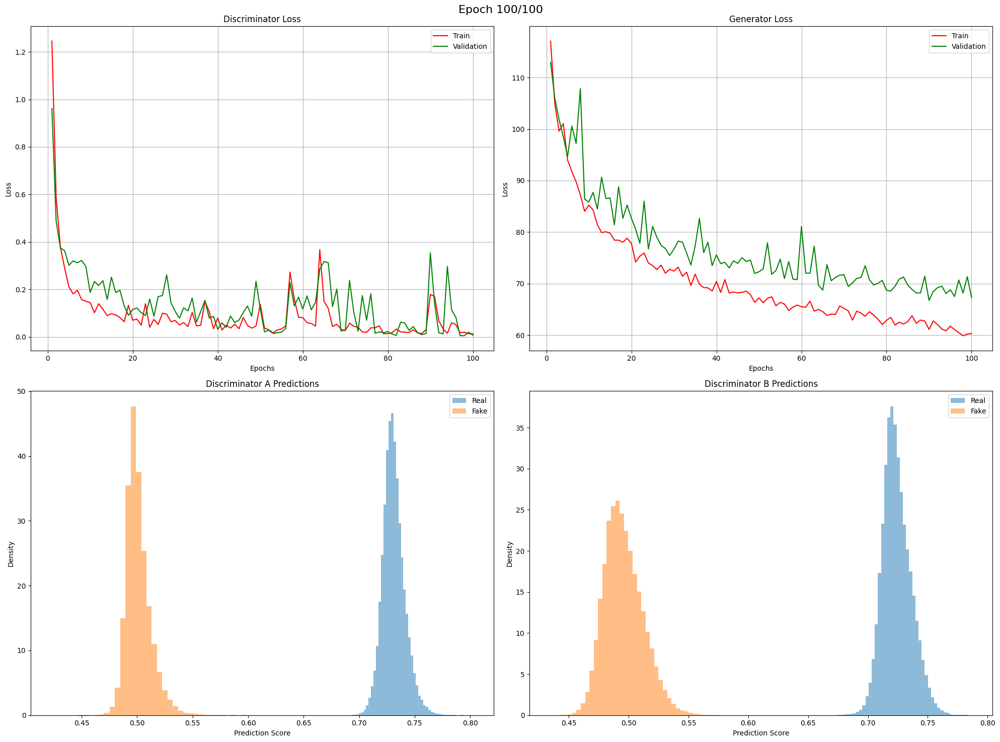

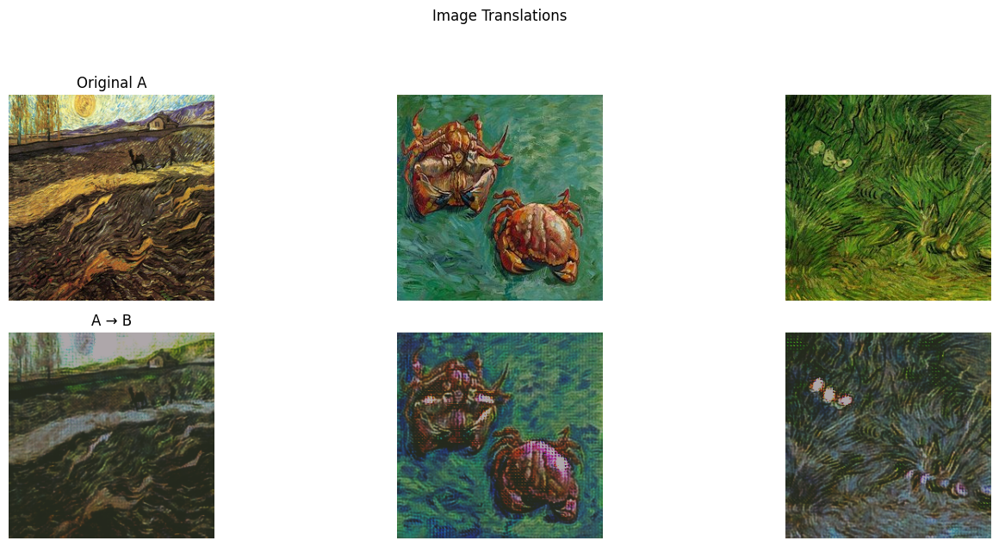

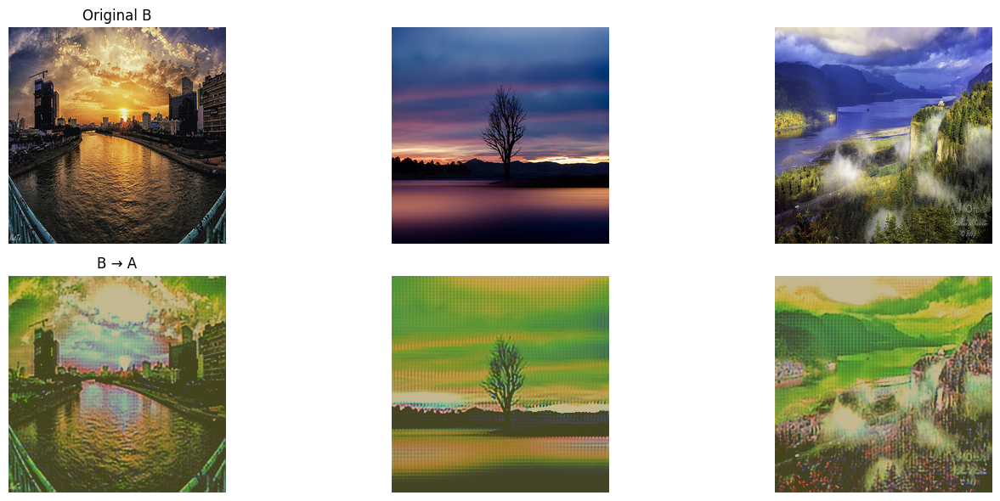

CPU times: user 2h 19min 37s, sys: 14min 18s, total: 2h 33min 55s
Wall time: 2h 38min 51s


In [77]:
%%time
model, optimizer_d, optimizer_g, plots = learning_loop(
    model = model,
    optimizer_g = optimizer_g,
    g_iters_per_epoch = 1,
    optimizer_d = optimizer_d,
    d_iters_per_epoch = 1,
    train_loader_a = dataloaders.train_a,
    train_loader_b = dataloaders.train_b,
    val_loader_a = dataloaders.test_a,
    val_loader_b = dataloaders.test_b,
    criterion_d = criterion_d,
    criterion_g = criterion_g,
    scheduler_g = scheduler_g,
    scheduler_d = scheduler_d,
    de_norm_a = de_normalize_a,
    de_norm_b = de_normalize_b,
    epochs = 100,
    min_lr = 1e-6,
    val_every = 1,
    draw_every = 1,
    chkp_folder = "./chkp",
    model_name = "cycle_gan",
    images_per_validation=3,
    plots=None,
    starting_epoch=0,
)

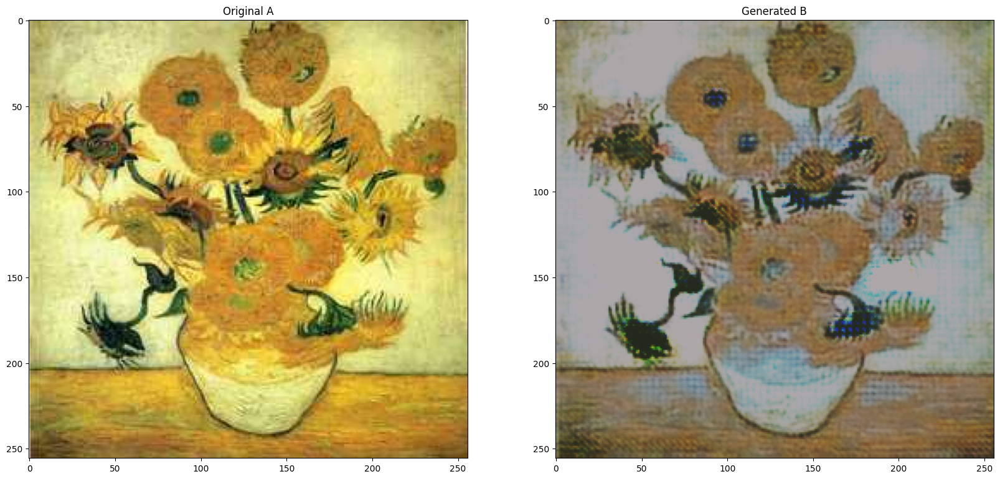

In [96]:
img_a = ds.test_a[111].to(device).unsqueeze(0)

plt.subplots(1, 2, figsize=(20, 10))

plt.subplot(121)
with torch.no_grad():
    img_a_cpu = img_a[0].cpu()
    denorm_img = de_normalize_a(img_a_cpu)
    if denorm_img.ndim == 3 and denorm_img.shape[0] == 3:  # Если (C,H,W)
        denorm_img = denorm_img.permute(1, 2, 0)  # Меняем на (H,W,C)
    plt.imshow(denorm_img.numpy())
    plt.title("Original A")

plt.subplot(122)
with torch.no_grad():
    fake_b = model.gen_A2B(img_a)[0].cpu()  # Используем gen_A2B вместо generators["a_to_b"]
    denorm_fake = de_normalize_b(fake_b)
    if denorm_fake.ndim == 3 and denorm_fake.shape[0] == 3:
        denorm_fake = denorm_fake.permute(1, 2, 0)
    plt.imshow(denorm_fake.numpy())
    plt.title("Generated B")

plt.show()

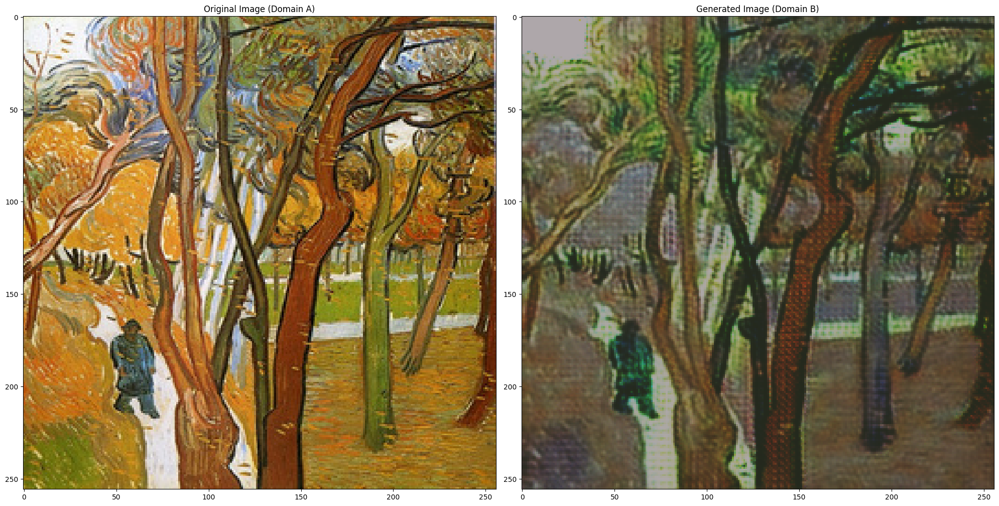

In [89]:
img_a = ds.test_a[5].to(device).unsqueeze(0)

plt.subplots(1, 2, figsize=(20, 10))

plt.subplot(121)
with torch.no_grad():
    img_a_cpu = img_a[0].cpu()
    denorm_img = de_normalize_a(img_a_cpu)
    if denorm_img.ndim == 3 and denorm_img.shape[0] == 3:  # Если формат (C, H, W)
        denorm_img = denorm_img.permute(1, 2, 0)  # Меняем на (H, W, C)
    plt.imshow(denorm_img.numpy())
    plt.title("Original Image (Domain A)")

plt.subplot(122)
with torch.no_grad():
    fake_b = model.gen_A2B(img_a)[0].cpu()
    denorm_fake = de_normalize_b(fake_b)
    if denorm_fake.ndim == 3 and denorm_fake.shape[0] == 3:
        denorm_fake = denorm_fake.permute(1, 2, 0)
    plt.imshow(denorm_fake.numpy())
    plt.title("Generated Image (Domain B)")

plt.tight_layout()
plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


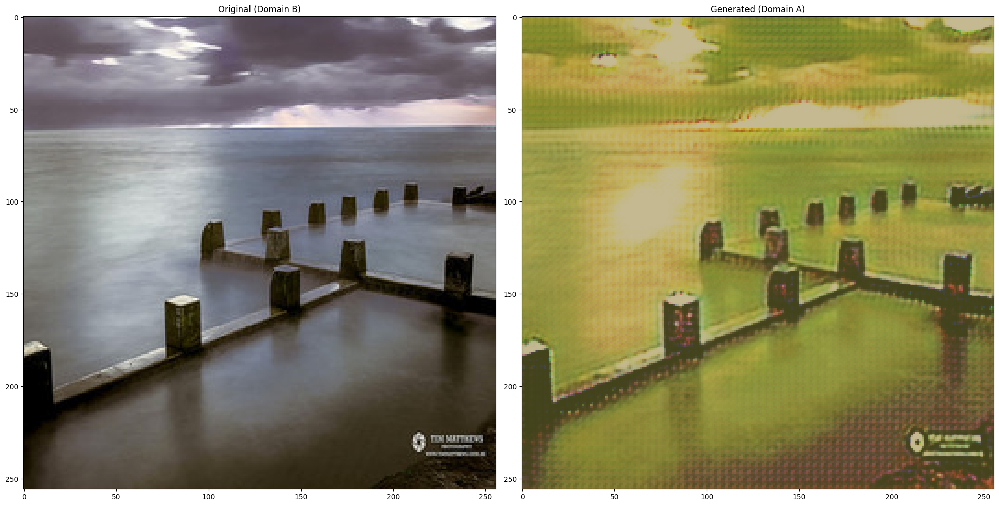

In [93]:
img_ind = 52
img_b = ds.test_b[img_ind].to(device).unsqueeze(0)

with torch.no_grad():
    fake_a = model.gen_B2A(img_b)  # Используем gen_B2A для преобразования B->A

plt.subplots(1, 2, figsize=(20, 10))

# Оригинал B
plt.subplot(121)
orig_b = de_normalize_b(img_b[0].cpu())
if orig_b.dim() == 3 and orig_b.shape[0] == 3:
    orig_b = orig_b.permute(1, 2, 0)
plt.imshow(orig_b.numpy())
plt.title("Original (Domain B)")

# Сгенерированный A
plt.subplot(122)
gen_a = de_normalize_a(fake_a[0].cpu())
if gen_a.dim() == 3 and gen_a.shape[0] == 3:
    gen_a = gen_a.permute(1, 2, 0)
plt.imshow(gen_a.numpy())
plt.title("Generated (Domain A)")

plt.tight_layout()
plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


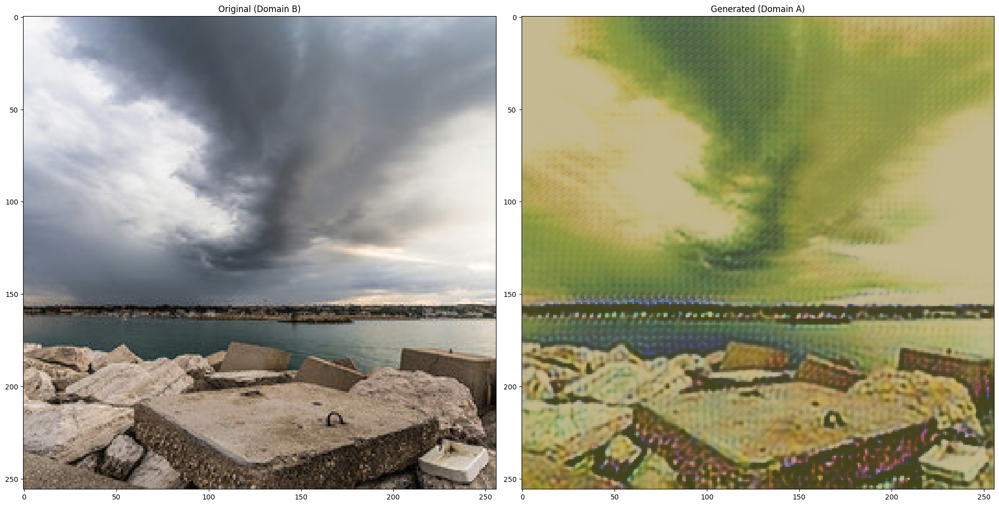

In [94]:
img_ind = 100
img_b = ds.test_b[img_ind].to(device).unsqueeze(0)

with torch.no_grad():
    fake_a = model.gen_B2A(img_b)  # Используем gen_B2A для преобразования B->A

plt.subplots(1, 2, figsize=(20, 10))

# Оригинал B
plt.subplot(121)
orig_b = de_normalize_b(img_b[0].cpu())
if orig_b.dim() == 3 and orig_b.shape[0] == 3:
    orig_b = orig_b.permute(1, 2, 0)
plt.imshow(orig_b.numpy())
plt.title("Original (Domain B)")

# Сгенерированный A
plt.subplot(122)
gen_a = de_normalize_a(fake_a[0].cpu())
if gen_a.dim() == 3 and gen_a.shape[0] == 3:
    gen_a = gen_a.permute(1, 2, 0)
plt.imshow(gen_a.numpy())
plt.title("Generated (Domain A)")

plt.tight_layout()
plt.show()

In [24]:
checkpoint_path = "chkp/cycle_gan_1_final.pt"
checkpoint = torch.load(checkpoint_path)

test_model = CycleGAN().to(device)
test_model.load_state_dict(checkpoint['model_state_dict'])
test_model.eval()

CycleGAN(
  (gen_A2B): Generator(
    (model): Sequential(
      (0): ReflectionPad2d((3, 3, 3, 3))
      (1): Conv2d(3, 64, kernel_size=(7, 7), stride=(1, 1))
      (2): InstanceNorm2d(64, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
      (3): ReLU(inplace=True)
      (4): Conv2d(64, 128, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
      (5): InstanceNorm2d(128, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
      (6): ReLU(inplace=True)
      (7): Conv2d(128, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
      (8): InstanceNorm2d(256, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
      (9): ReLU(inplace=True)
      (10): ResidualBlock(
        (block): Sequential(
          (0): ReflectionPad2d((1, 1, 1, 1))
          (1): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1))
          (2): InstanceNorm2d(256, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
          (3): ReLU(inplace=True)


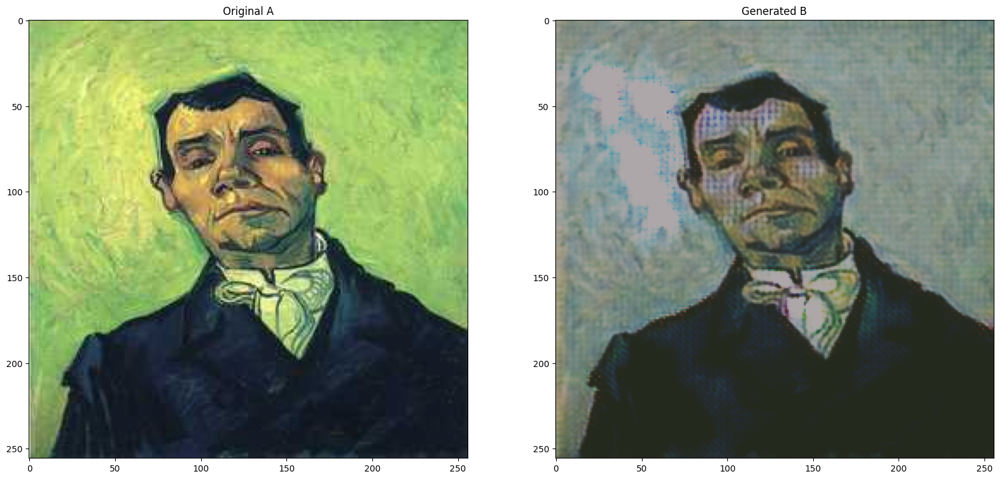

In [25]:
img_a = ds.test_a[42].to(device).unsqueeze(0)

plt.subplots(1, 2, figsize=(20, 10))

plt.subplot(121)
with torch.no_grad():
    img_a_cpu = img_a[0].cpu()
    denorm_img = de_normalize_a(img_a_cpu)
    if denorm_img.ndim == 3 and denorm_img.shape[0] == 3:  # Если (C,H,W)
        denorm_img = denorm_img.permute(1, 2, 0)  # Меняем на (H,W,C)
    plt.imshow(denorm_img.numpy())
    plt.title("Original A")

plt.subplot(122)
with torch.no_grad():
    fake_b = test_model.gen_A2B(img_a)[0].cpu()  # Используем gen_A2B вместо generators["a_to_b"]
    denorm_fake = de_normalize_b(fake_b)
    if denorm_fake.ndim == 3 and denorm_fake.shape[0] == 3:
        denorm_fake = denorm_fake.permute(1, 2, 0)
    plt.imshow(denorm_fake.numpy())
    plt.title("Generated B")

plt.show()

# 5. Свои данные (___3 балла + бонусы___)

В этой части необходимо выполнить следующее:

1. **Создание датасетов**  
   * Соберите один или пару небольших датасета (минимум 100 примеров, но чем больше, тем лучше).  
   * Дайте волю фантазии, но избегайте неадекватного контента, объема данных или данных за рамками норм.  

2. **Обучение CycleGAN**  
   * Обучите модель CycleGAN для преобразования между вашим датасетом (**домен A**) и другим датасетом (**домен B**).  
   * Второй датасет может быть вашим собственным или любым существующим  

3. **Требования к сдаче**  
   * **Архив с датасетами**:  
     Приложите ссылку на заархивированные данные или загрузите сам архив с данными, использованные для обучения.  
   * **Jupyter Notebook**:  
     * Визуализируйте примеры из доменов A и B с кратким описанием идеи (например, "преобразование эскизов в цветные рисунки").  
     * Добавьте код обучения модели (архитектура, гиперпараметры, функция потерь).  
     * Покажите результаты работы модели (минимум по 5 примеров преобразований A→B и B→A).  
   * **Hugging Face Space + Streamlit**:  
     * Разработайте интерактивное приложение с использованием Streamlit, которое позволяет:  
       - Загружать изображения из доменов A и B.  
       - Отображать результаты преобразований (A→B и B→A) в реальном времени.  
     * Выложите приложение в Hugging Face Space и приложите ссылку на него.  
     * Убедитесь, что модель интегрирована в приложение, а проверяющие могут самостоятельно тестировать её через интерфейс.  

4. **Критерии оценки**  
   * Дополнительные баллы начисляются за:  
     - Креативные и качественные датасеты.  
     - Высокое качество преобразований (четкость, сохранение структуры, отсутствие артефактов).  
     - Удобный и наглядный интерфейс Streamlit-приложения.  

**Примеры идей для датасетов**:  
- Эскизы → Реалистичные изображения.  
- Дневные фото → Ночные фото.  
- Картины в стиле импрессионизма → фотореализм.  

**Важно**:  
- Проверяющий будет оценивать работу через ваше Streamlit-приложение. Убедитесь, что инференс работает стабильно.  
- Если модель слишком велика для деплоя, используйте оптимизацию.  

___Удачи!___ 🚀

Домен А -- собаки, домен В -- маффины

Тут ничего не получилось, м

In [27]:
import os
import shutil
from sklearn.model_selection import train_test_split

# Пути к данным
source_path = "datasets/img2img/g-dogs2muffins"  # Исходная папка с неправильной структурой
target_path = "datasets/img2img/dogs2muffins"  # Новая папка с правильной структурой

# Создаем целевую структуру папок
os.makedirs(os.path.join(target_path, "trainA"), exist_ok=True)  # Собаки (train)
os.makedirs(os.path.join(target_path, "trainB"), exist_ok=True)  # Маффины (train)
os.makedirs(os.path.join(target_path, "testA"), exist_ok=True)   # Собаки (test)
os.makedirs(os.path.join(target_path, "testB"), exist_ok=True)   # Маффины (test)

# Функция для копирования и ресайза изображений
def process_images(source_dir, target_dir, resize_to=(256, 256)):
    for filename in os.listdir(source_dir):
        if filename.lower().endswith(('.png', '.jpg', '.jpeg')):
            src = os.path.join(source_dir, filename)
            dst = os.path.join(target_dir, filename)
            
            # Копируем файл (можно добавить ресайз при необходимости)
            shutil.copy2(src, dst)

# Обрабатываем тренировочные данные
print("Обработка тренировочных данных...")
process_images(os.path.join(source_path, "train/chihuahua"), os.path.join(target_path, "trainA"))
process_images(os.path.join(source_path, "train/muffin"), os.path.join(target_path, "trainB"))

# Обрабатываем тестовые данные
print("Обработка тестовых данных...")
process_images(os.path.join(source_path, "test/chihuahua"), os.path.join(target_path, "testA"))
process_images(os.path.join(source_path, "test/muffin"), os.path.join(target_path, "testB"))

print("Структура успешно преобразована!")
print(f"Результат сохранен в: {target_path}")

# Проверяем количество файлов в каждой папке
print("\nПроверка количества изображений:")
print(f"trainA (собаки): {len(os.listdir(os.path.join(target_path, 'trainA')))}")
print(f"trainB (маффины): {len(os.listdir(os.path.join(target_path, 'trainB')))}")
print(f"testA (собаки): {len(os.listdir(os.path.join(target_path, 'testA')))}")
print(f"testB (маффины): {len(os.listdir(os.path.join(target_path, 'testB')))}")

Обработка тренировочных данных...
Обработка тестовых данных...
Структура успешно преобразована!
Результат сохранен в: datasets/img2img/dogs2muffins

Проверка количества изображений:
trainA (собаки): 2559
trainB (маффины): 447
testA (собаки): 640
testB (маффины): 544


In [48]:
def resize_all_images(input_folder, output_folder, size=(256, 256)):
    os.makedirs(output_folder, exist_ok=True)
    for file in os.listdir(input_folder):
        if file.lower().endswith(('.png', '.jpg', '.jpeg')):
            try:
                img = Image.open(os.path.join(input_folder, file))
                img = img.resize(size, Image.LANCZOS)
                img.save(os.path.join(output_folder, file))
            except Exception as e:
                print(f"Ошибка обработки {file}: {e}")

print("Start resizing")
print("trainA")
# resize_all_images("datasets/img2img/dogs2muffins/trainA", "datasets/img2img/dogs2muffins_cor/trainA")
print("trainB")
resize_all_images("datasets/img2img/dogs2muffins/trainB", "datasets/img2img/dogs2muffins_cor/trainB")
print("testA")
# resize_all_images("datasets/img2img/dogs2muffins/testA", "datasets/img2img/dogs2muffins_cor/testA")
print("testB")
resize_all_images("datasets/img2img/dogs2muffins/testB", "datasets/img2img/dogs2muffins_cor/testB")

Start resizing
trainA
trainB
testA
testB


In [21]:
dataset_folder = "/home/jupyter/datasphere/project/datasets/img2img"
dataset_name = "dogs2muffins_cor"
target_folder = os.path.join(dataset_folder, dataset_name)

ds = DatasetsClass(
    train_a=ImageDatasetNoLabel(os.path.join(target_folder, "trainA")),
    train_b=ImageDatasetNoLabel(os.path.join(target_folder, "trainB")),
    test_a=ImageDatasetNoLabel(os.path.join(target_folder, "testA")),
    test_b=ImageDatasetNoLabel(os.path.join(target_folder, "testB")),
)

In [22]:
channel_mean_a, channel_std_a = get_channel_statistics(ds.train_a)
print(f"Domain A (dogs): mean={channel_mean_a}, std={channel_std_a}")

# Поканальное среднее и отклонение для B
channel_mean_b, channel_std_b = get_channel_statistics(ds.train_b)
print(f"Domain B (muffins): mean={channel_mean_b}, std={channel_mean_b}")

Domain A (dogs): mean=(0.6537297882660845, 0.6134018707334785, 0.5685476743109923), std=(0.3094490677300584, 0.31164365501757446, 0.3313284723243879)
Domain B (muffins): mean=(0.664142556471846, 0.5898836984463719, 0.5165135395740236), std=(0.664142556471846, 0.5898836984463719, 0.5165135395740236)


In [23]:
from PIL import Image
import os

def check_image_sizes(folder):
    sizes = set()
    for root, _, files in os.walk(folder):
        for file in files:
            if file.lower().endswith(('.png', '.jpg', '.jpeg')):
                try:
                    img = Image.open(os.path.join(root, file))
                    sizes.add(img.size)
                except:
                    print(f"Ошибка чтения: {file}")
    return sizes

print("Размеры в trainA:", check_image_sizes("datasets/img2img/dogs2muffins_cor/testB"))

Размеры в trainA: {(256, 256)}


Domain A (dogs):


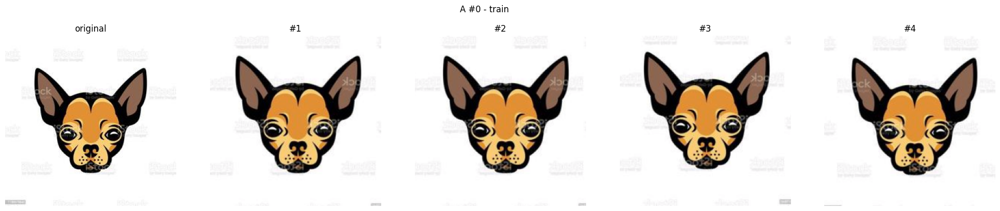

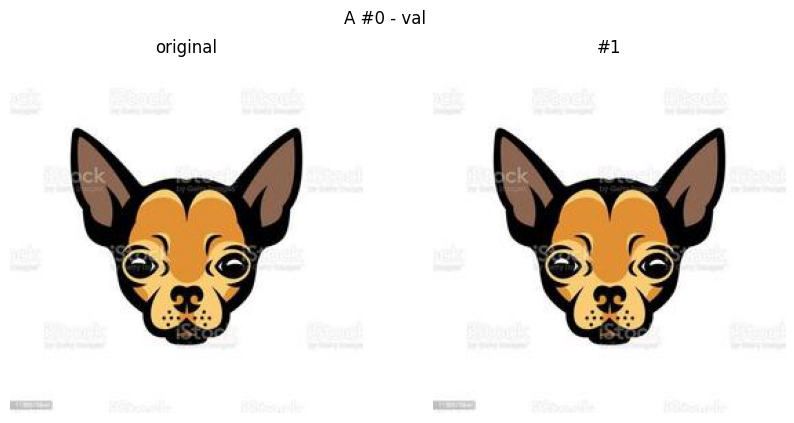


Domain B (muffins):


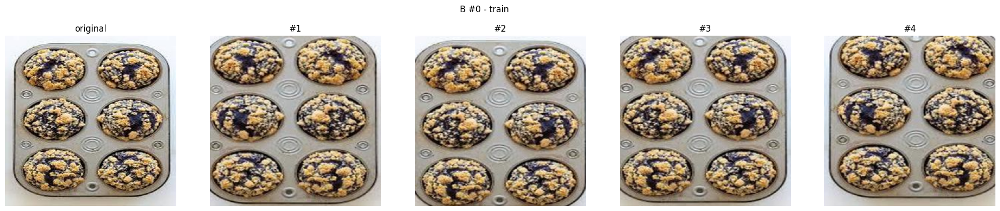

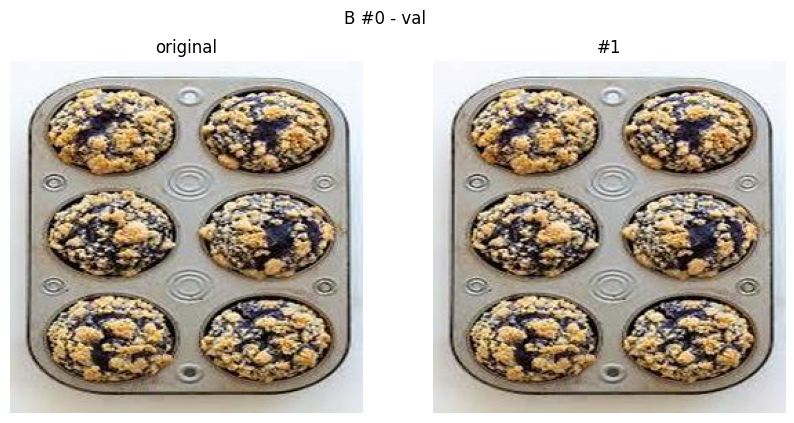

In [24]:
hyperparams = dict(
    img_size=256,       # Размер изображения
    augment=True        # Использовать аугментации для обучения
)

# Трансформы для доменов A и B
train_transform_a, val_transform_a, de_normalize_a = get_transforms(
    mean=channel_mean_a, 
    std=channel_std_a, 
    **hyperparams
)
train_transform_b, val_transform_b, de_normalize_b = get_transforms(
    mean=channel_mean_b, 
    std=channel_std_b, 
    **hyperparams
)
print("Domain A (dogs):")
show_examples(ds.train_a, train_transform_a, de_normalize_a, num_per_image=4, image_index=0, title="A #0 - train")
show_examples(ds.train_a, val_transform_a, de_normalize_a, num_per_image=1, image_index=0, title="A #0 - val")

print("\nDomain B (muffins):")
show_examples(ds.train_b, train_transform_b, de_normalize_b, num_per_image=4, image_index=0, title="B #0 - train")
show_examples(ds.train_b, val_transform_b, de_normalize_b, num_per_image=1, image_index=0, title="B #0 - val")

In [25]:
# Все датасеты с трансформами
ds = DatasetsClass(
    train_a=ImageDatasetNoLabel(
        os.path.join(target_folder, "trainA"),
        transform=train_transform_a,  # Аугментации для тренировочных данных домена A
    ),
    train_b=ImageDatasetNoLabel(
        os.path.join(target_folder, "trainB"),
        transform=train_transform_b,  # Аугментации для тренировочных данных домена B
    ),
    test_a=ImageDatasetNoLabel(
        os.path.join(target_folder, "testA"),
        transform=val_transform_a,  # Без аугментаций для тестовых данных
    ),
    test_b=ImageDatasetNoLabel(
        os.path.join(target_folder, "testB"),
        transform=val_transform_b,  # Без аугментаций для тестовых данных
    ),
)

# Проверка размеров датасетов
print(f"Train A size: {len(ds.train_a)} images")
print(f"Train B size: {len(ds.train_b)} images")
print(f"Test A size: {len(ds.test_a)} images")
print(f"Test B size: {len(ds.test_b)} images")

check_sample(ds.train_a, "Train A")
check_sample(ds.train_b, "Train B")
check_sample(ds.test_a, "Test A")
check_sample(ds.test_b, "Test B")

Train A size: 2559 images
Train B size: 447 images
Test A size: 640 images
Test B size: 544 images

Train A sample:
Type: <class 'torch.Tensor'>
Shape: torch.Size([3, 256, 256])
Min: -2.113, Max: 1.302

Train B sample:
Type: <class 'torch.Tensor'>
Shape: torch.Size([3, 256, 256])
Min: -2.407, Max: 1.576

Test A sample:
Type: <class 'torch.Tensor'>
Shape: torch.Size([3, 256, 256])
Min: -2.113, Max: 1.302

Test B sample:
Type: <class 'torch.Tensor'>
Shape: torch.Size([3, 256, 256])
Min: -2.350, Max: 1.576


In [27]:
batch_size = 8

base_dataloaders = DataLoadersClass(
    train_a=DataLoader(
        dataset=ds.train_a,
        batch_size=batch_size,
        shuffle=True,
        drop_last=True,
        num_workers=2,
        pin_memory=True
    ),
    train_b=DataLoader(
        dataset=ds.train_b,
        batch_size=batch_size,
        shuffle=True,
        drop_last=True,
        num_workers=2,
        pin_memory=True
    ),
    test_a=DataLoader(
        dataset=ds.test_a,
        batch_size=batch_size,
        shuffle=False,
        drop_last=False,
        num_workers=2,
        pin_memory=True
    ),
    test_b=DataLoader(
        dataset=ds.test_b,
        batch_size=batch_size,
        shuffle=False,
        drop_last=False,
        num_workers=2,
        pin_memory=True
    ),
)

# Определяем устройство (GPU если доступно)
device = torch.device('cuda:0') if torch.cuda.is_available() else torch.device('cpu')

# Обертываем DataLoader'ы для автоматического переноса на устройство
dataloaders = DataLoadersClass(
    train_a=DeviceDataLoader(base_dataloaders.train_a, device),
    train_b=DeviceDataLoader(base_dataloaders.train_b, device),
    test_a=DeviceDataLoader(base_dataloaders.test_a, device),
    test_b=DeviceDataLoader(base_dataloaders.test_b, device)
)

# Проверка балансировки
print(f"Device: {device}")
print(f"Original sizes: TrainA={len(ds.train_a)}, TrainB={len(ds.train_b)}")
print(f"Effective batch sizes: TrainA={batch_size}, TrainB={batch_size}")
print(f"Train iterations per epoch: {len(dataloaders.train_a)}")

Device: cuda:0
Original sizes: TrainA=2559, TrainB=447
Effective batch sizes: TrainA=8, TrainB=8
Train iterations per epoch: 319


In [28]:
# Инициализация устройства
device = torch.device('cuda:0') if torch.cuda.is_available() else torch.device('cpu')
print(f"Using device: {device}")

# Параметры модели
model_params = {
    'img_channels': 3,          # RGB изображения
    'features': 64,             # Число каналов в первом слое
    'residual_blocks': 9        # Количество residual блоков в генераторе
}

# Создаем модель и оптимизаторы
model, optimizer_d, optimizer_g = create_model_and_optimizer(
    model_class=CycleGAN,
    model_params=model_params,
    lr=2e-4,                    # Learning rate из оригинальной статьи
    betas=(0.5, 0.999),         # Параметры для Adam
    device=device
)

# Шедулеры для регулировки learning rate
scheduler_d = torch.optim.lr_scheduler.LambdaLR(
    optimizer_d,
    lr_lambda=lambda epoch: 2.0 - max(0, epoch - 100) / 100.0  # Linear decay после 100 эпох
)

scheduler_g = torch.optim.lr_scheduler.LambdaLR(
    optimizer_g,
    lr_lambda=lambda epoch: 2.0 - max(0, epoch - 100) / 100.0
)

# Функции потерь
criterion_d = FullDiscriminatorLoss(is_mse=True)  # Используем MSE loss для стабильности
criterion_g = FullGeneratorLoss(
    lambda_cyc=3.0,            # Вес cycle consistency loss (из статьи)
    is_mse=True                 # Согласованность с дискриминатором
)

sum_params, sum_learnable_params = model_num_params(model, verbose_all=False)

Using device: cuda:0
Model architecture:
CycleGAN(
  (gen_A2B): Generator(
    (model): Sequential(
      (0): ReflectionPad2d((3, 3, 3, 3))
      (1): Conv2d(3, 64, kernel_size=(7, 7), stride=(1, 1))
      (2): InstanceNorm2d(64, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
      (3): ReLU(inplace=True)
      (4): Conv2d(64, 128, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
      (5): InstanceNorm2d(128, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
      (6): ReLU(inplace=True)
      (7): Conv2d(128, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
      (8): InstanceNorm2d(256, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
      (9): ReLU(inplace=True)
      (10): ResidualBlock(
        (block): Sequential(
          (0): ReflectionPad2d((1, 1, 1, 1))
          (1): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1))
          (2): InstanceNorm2d(256, eps=1e-05, momentum=0.1, affine=False, track_running_stats=

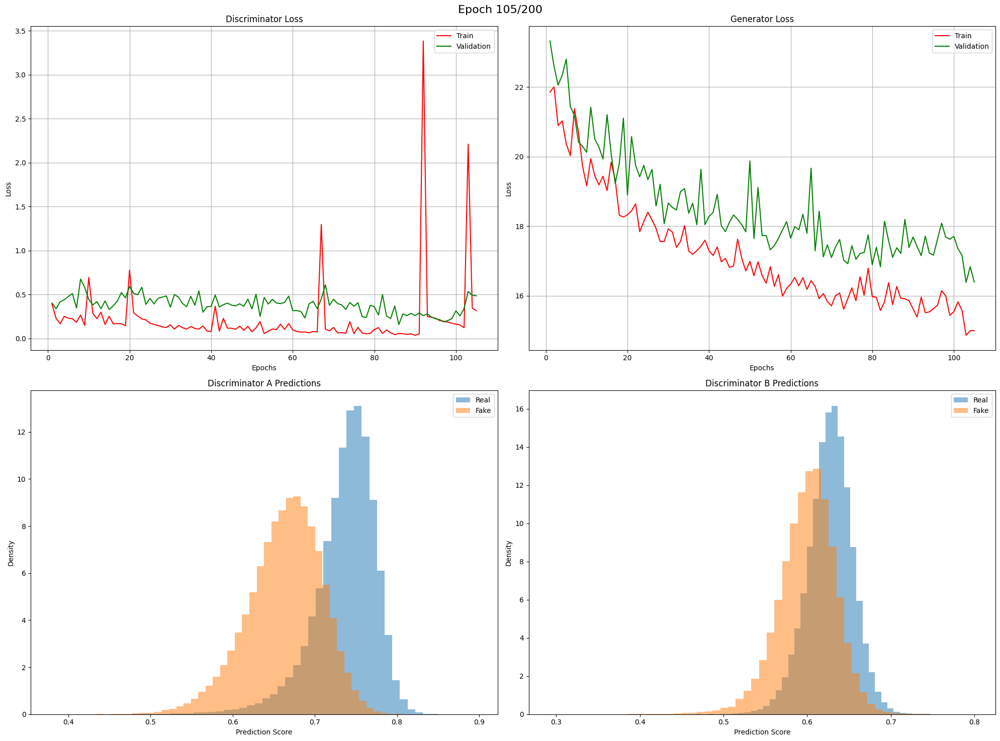

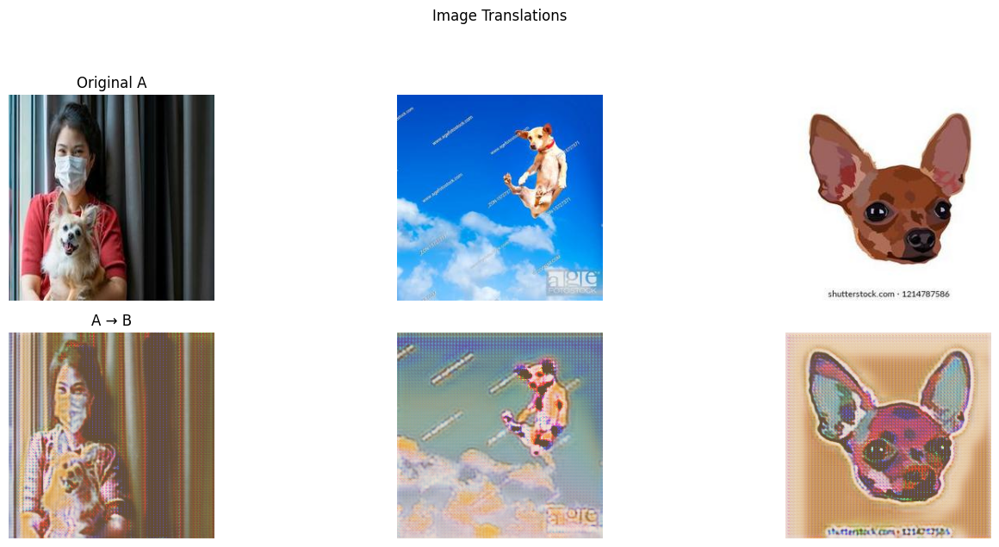

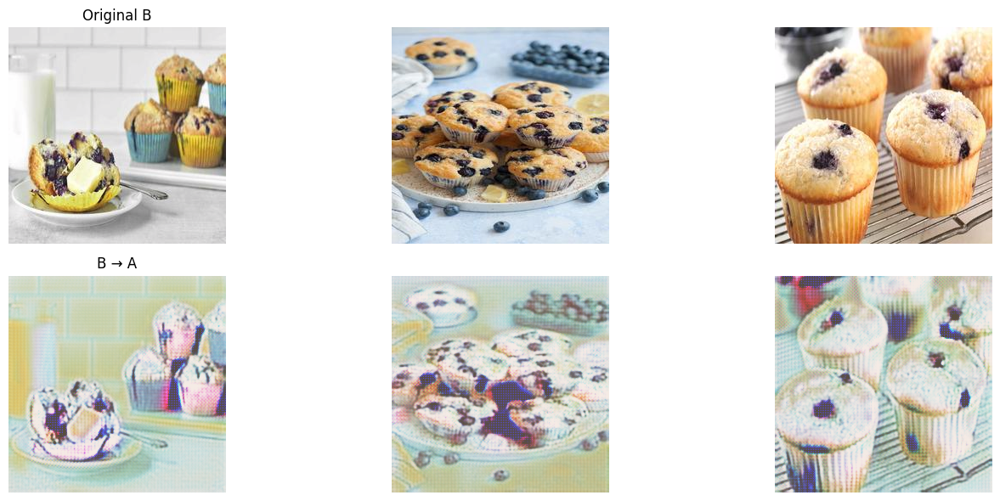

Epoch 106/200
Training discriminators...


Training Discriminators: 100%|██████████| 55/55 [00:03<00:00, 17.81it/s]


Training generators...


Training Generators: 100%|██████████| 55/55 [00:15<00:00,  3.58it/s]


Validating...


Validation: 100%|██████████| 68/68 [00:08<00:00,  8.03it/s]


In [ ]:
%%time
model, optimizer_d, optimizer_g, plots = learning_loop(
    model = model,
    optimizer_g = optimizer_g,
    g_iters_per_epoch = 1,
    optimizer_d = optimizer_d,
    d_iters_per_epoch = 1,
    train_loader_a = dataloaders.train_a,
    train_loader_b = dataloaders.train_b,
    val_loader_a = dataloaders.test_a,
    val_loader_b = dataloaders.test_b,
    criterion_d = criterion_d,
    criterion_g = criterion_g,
    scheduler_g = scheduler_g,
    scheduler_d = scheduler_d,
    de_norm_a = de_normalize_a,
    de_norm_b = de_normalize_b,
    epochs = 200,
    min_lr = 1e-6,
    val_every = 1,
    draw_every = 1,
    chkp_folder = "./chkp_dogs2muffins",
    model_name = "cycle_gan_dogs2muffins",
    images_per_validation=3,
    plots=None,
    starting_epoch=0,
)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


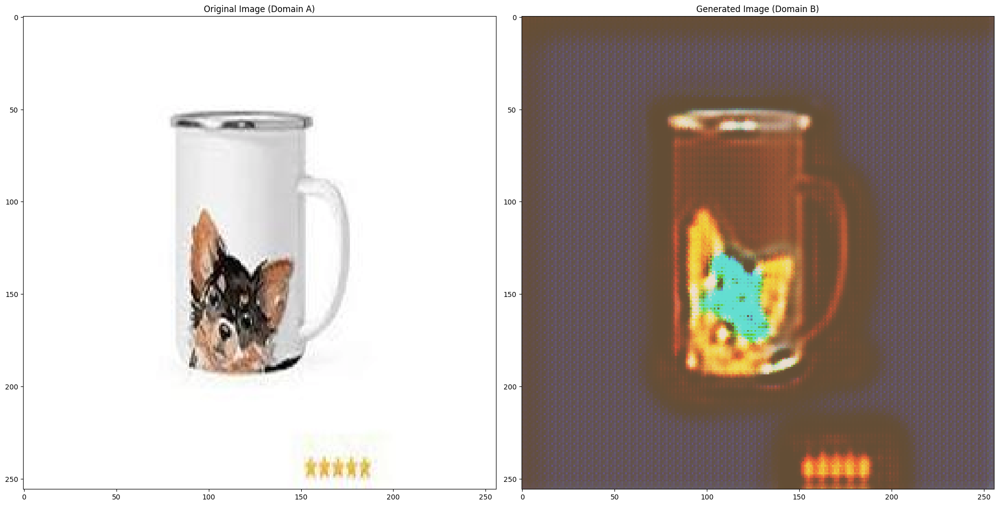

In [90]:
img_a = ds.test_a[152].to(device).unsqueeze(0)

plt.subplots(1, 2, figsize=(20, 10))

plt.subplot(121)
with torch.no_grad():
    img_a_cpu = img_a[0].cpu()
    denorm_img = de_normalize_a(img_a_cpu)
    if denorm_img.ndim == 3 and denorm_img.shape[0] == 3:  # Если формат (C, H, W)
        denorm_img = denorm_img.permute(1, 2, 0)  # Меняем на (H, W, C)
    plt.imshow(denorm_img.numpy())
    plt.title("Original Image (Domain A)")

plt.subplot(122)
with torch.no_grad():
    fake_b = model.gen_A2B(img_a)[0].cpu()
    denorm_fake = de_normalize_b(fake_b)
    if denorm_fake.ndim == 3 and denorm_fake.shape[0] == 3:
        denorm_fake = denorm_fake.permute(1, 2, 0)
    plt.imshow(denorm_fake.numpy())
    plt.title("Generated Image (Domain B)")

plt.tight_layout()
plt.show()